# House Price Prediction

A US-based housing company named Surprise Housing has decided to enter the Australian market. The company uses data analytics to purchase houses at a price below their actual values and flip them on at a higher price. For the same purpose, the company has collected a data set from the sale of houses in Australia.

The data is provided in the CSV file below.

The company is looking at prospective properties to buy to enter the market. You are required to build a regression model using regularisation in order to predict the actual value of the prospective properties and decide whether to invest in them or not.

## Objective

The company wants to know:
-   Which variables are significant in predicting the price of a house, and
-   How well those variables describe the price of a house.

## Business Goal

You are required to model the price of houses with the available independent variables. This model will then be used by the management to understand how exactly the prices vary with the variables. They can accordingly manipulate the strategy of the firm and concentrate on areas that will yield high returns. Further, the model will be a good way for management to understand the pricing dynamics of a new market.



In [1]:
#Load Libraries

import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 

from sklearn.model_selection import train_test_split,KFold,GridSearchCV
from sklearn.feature_selection import RFE
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.metrics import r2_score
import statsmodels.api as sm  
from statsmodels.stats.outliers_influence import variance_inflation_factor

import os
import warnings
warnings.filterwarnings('ignore')

np.random.seed(42)
sns.set_style('darkgrid')
pd.set_option('display.max_columns', 500)

## Load Dataset and Data Definition

In [2]:
# Load dataframe
housing_df = pd.read_csv('./train.csv')
housing_df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [3]:
# Load Data Definition
with open('./data_description.txt') as f:
    print(f.read())

MSSubClass: Identifies the type of dwelling involved in the sale.	

        20	1-STORY 1946 & NEWER ALL STYLES
        30	1-STORY 1945 & OLDER
        40	1-STORY W/FINISHED ATTIC ALL AGES
        45	1-1/2 STORY - UNFINISHED ALL AGES
        50	1-1/2 STORY FINISHED ALL AGES
        60	2-STORY 1946 & NEWER
        70	2-STORY 1945 & OLDER
        75	2-1/2 STORY ALL AGES
        80	SPLIT OR MULTI-LEVEL
        85	SPLIT FOYER
        90	DUPLEX - ALL STYLES AND AGES
       120	1-STORY PUD (Planned Unit Development) - 1946 & NEWER
       150	1-1/2 STORY PUD - ALL AGES
       160	2-STORY PUD - 1946 & NEWER
       180	PUD - MULTILEVEL - INCL SPLIT LEV/FOYER
       190	2 FAMILY CONVERSION - ALL STYLES AND AGES

MSZoning: Identifies the general zoning classification of the sale.
		
       A	Agriculture
       C	Commercial
       FV	Floating Village Residential
       I	Industrial
       RH	Residential High Density
       RL	Residential Low Density
       RP	Residential Low Density Park 
       RM

__ The Target or Independent Variable that we have to predict is the `SalePrice` column. __

## Exploratory Data Analysis

1.  We will check the data type for every feature and verify that it matches the data definition.
2.  Let us check and analyze different statistical properties for the given dataset.
3.  We will look into the categorical and continous features separately.


In [4]:
housing_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

_Perhaps the `Id` column is redundant and can be dropped._

In [5]:
housing_df.drop(columns='Id',inplace=True)

_Although the columns `MSSubClass`, `OverallQual`, `OverallCond` are supposed to contain categorical information, yet the data type is `Int64`._

We have to treat these features.

__Describe Statistics__

In [6]:
housing_df.describe()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


_As we can observe, the maximun SalePrice is `755000` and the minimum is `34900`._ </br>
_The Median price is `163000` and the Mean price is `180921`._

__Missing Values__

Fill missing values in columns having NA as values as None and for the rest fill with median or mean

Lets check the missing values in the features and decide on how to handle them.

In [7]:
def find_missing_values(df):
    total = df.isnull().sum().sort_values(ascending=False)
    percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
    missing_data = pd.concat([total,percent],axis=1,keys=['Total','Percent'])
    plt.title('Missing Values')
  
    return missing_data

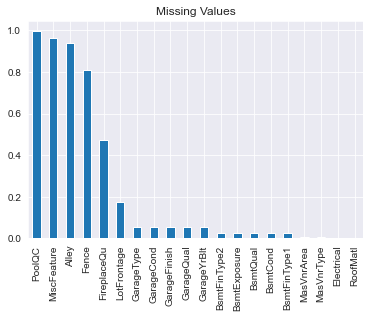

,Total,Percent
PoolQC,1453,0.995205
MiscFeature,1406,0.963014
Alley,1369,0.937671
Fence,1179,0.807534
FireplaceQu,690,0.472603
LotFrontage,259,0.177397
GarageType,81,0.055479
GarageCond,81,0.055479
GarageFinish,81,0.055479
GarageQual,81,0.055479


In [8]:
missing_data = find_missing_values(housing_df)
missing_data['Percent'].head(20).plot.bar()
plt.show()
missing_data.head(20)

On looking at the dictionary we can find that many of the categorical columns have `NA` as one of the categories which is being mistaken by pandas as a missing values.
Having a missing value can actually mean that the feature is not available for that particular house.

We will handle this first before handling the missing values.

In [9]:
# columns with NA as a category 
cols_with_na_category = ['MiscFeature','Alley','Fence','FireplaceQu',
               'GarageQual','GarageCond','GarageFinish','GarageType',
               'BsmtExposure','BsmtCond','BsmtQual','BsmtFinType1','BsmtFinType2','PoolQC']

# replace 'Na' with 'None' in these columns
for col in cols_with_na_category:
    housing_df[col].fillna('None',inplace=True)

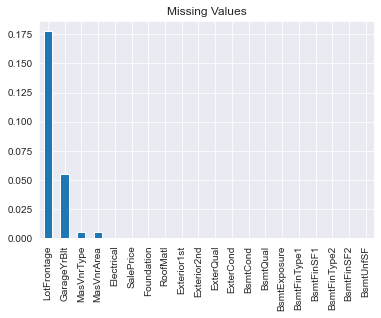

,Total,Percent
LotFrontage,259,0.177397
GarageYrBlt,81,0.055479
MasVnrType,8,0.005479
MasVnrArea,8,0.005479
Electrical,1,0.000685
SalePrice,0,0.000000
Foundation,0,0.000000
RoofMatl,0,0.000000
Exterior1st,0,0.000000
Exterior2nd,0,0.000000


In [10]:
# Lets Check missing values again
missing_data = find_missing_values(housing_df)
missing_data['Percent'].head(20).plot.bar()
plt.show()
missing_data.head(20)

_Before deciding on the method of imputing missing values, lets check for outliers in the columns._

In [11]:
housing_df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,None,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,None,None,None,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,None,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,None,None,None,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,None,None,None,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,None,None,None,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,None,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,None,None,None,0,12,2008,WD,Normal,250000


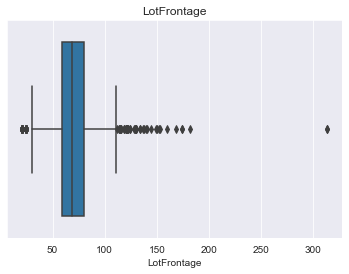

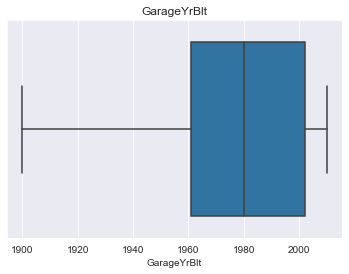

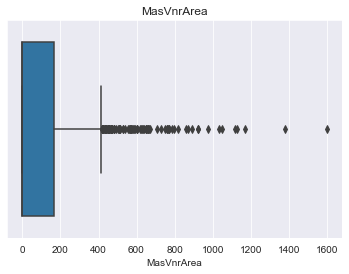

In [12]:
num_feat_missing = ['LotFrontage','GarageYrBlt','MasVnrArea']# Numerical features with missing values.
for col in num_feat_missing:
    plt.title(col)
    sns.boxplot(x = housing_df[col])
    plt.show()

_There seems to be a lot of outliers, we will use median to impute the missing values._

In [13]:
housing_df[num_feat_missing] = housing_df[num_feat_missing].fillna(housing_df[num_feat_missing].median())

In [14]:
housing_df['MasVnrType'].value_counts()

None       864
BrkFace    445
Stone      128
BrkCmn      15
Name: MasVnrType, dtype: int64

In [15]:
housing_df['Electrical'].value_counts()

SBrkr    1334
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64

In [16]:
# For categorical variables we will use mode imputation
housing_df['MasVnrType'] = housing_df['MasVnrType'].fillna('None')
housing_df['Electrical'] = housing_df['Electrical'].fillna('SBrkr')

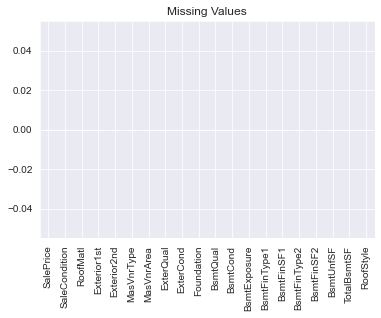

,Total,Percent
SalePrice,0,0.0
SaleCondition,0,0.0
RoofMatl,0,0.0
Exterior1st,0,0.0
Exterior2nd,0,0.0
MasVnrType,0,0.0
MasVnrArea,0,0.0
ExterQual,0,0.0
ExterCond,0,0.0
Foundation,0,0.0


In [17]:
# Lets Check missing values again
missing_data = find_missing_values(housing_df)
missing_data['Percent'].head(20).plot.bar()
plt.show()
missing_data.head(20)

Now there are no more missing values in our dataset.

#### Separate Numerical, Discrete and Categorical Features

We will Separate the three types of Features for our analysis.

In [18]:
num_features_df = housing_df.select_dtypes(exclude=['object'])
categorical_features_df = housing_df.select_dtypes(include=['object'])

In [19]:
num_features_df.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,60,65.0,8450,7,5,2003,2003,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0,2,2008,208500
1,20,80.0,9600,6,8,1976,1976,0.0,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,0,5,2007,181500
2,60,68.0,11250,7,5,2001,2002,162.0,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,0,9,2008,223500
3,70,60.0,9550,7,5,1915,1970,0.0,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,0,2,2006,140000
4,60,84.0,14260,8,5,2000,2000,350.0,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,2000.0,3,836,192,84,0,0,0,0,0,12,2008,250000


_Some of the features are categorical in nature although being numerical. We have separate them from analysis_.

#### Relation of Temporal Features with the Target

In [20]:
# Extract Year Features
year_features = [feature for feature in num_features_df.columns if 'Yr' in feature or 'Year' in feature]

print(f'Year Features are: {year_features}')

Year Features are: ['YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold']


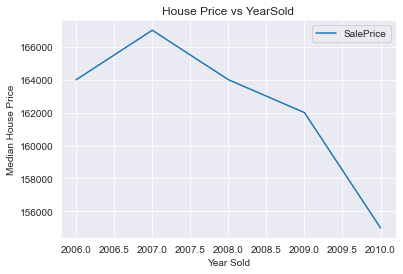

In [21]:
# Year Sold Vs SalePrice
housing_df.groupby('YrSold').agg({'SalePrice':'median'}).plot()
plt.xlabel('Year Sold')
plt.ylabel('Median House Price')
plt.title("House Price vs YearSold")
plt.show()

The Median sale price seems to be decreasing which should not be the case. <br>
We will examine this behavior further by taking the difference between the year features and when it was sold.

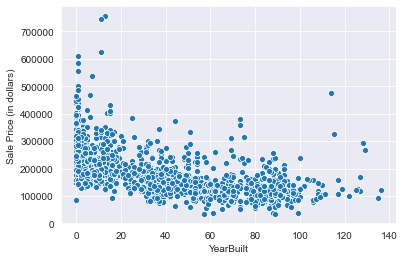

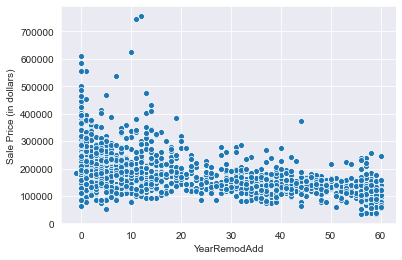

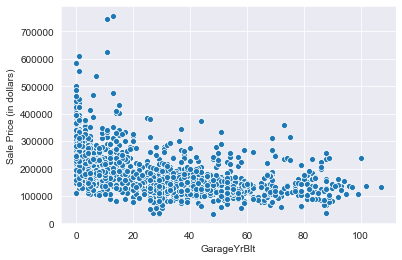

In [22]:
for feature in year_features:
    if feature != 'YrSold':
        year_diff_df = housing_df.copy()
        year_diff_df[feature]=year_diff_df['YrSold']-year_diff_df[feature]
        sns.scatterplot(x =feature, y= 'SalePrice', data =year_diff_df )
        plt.ylabel('Sale Price (in dollars)')
        plt.xlabel(f"{feature}")
        plt.show()

We can easily say from the above observations that if the house is relatively new or even if the modifications done to it are recent,<br>
it will attract higher Sale price.

#### Discrete features

We will examine these features which are continous but can only take a handful of values.


In [23]:
discrete_features = [feature for feature in num_features_df.columns \
                    if len(num_features_df[feature].unique())<25 \
                        and feature not in year_features]

print(f'The discrete features are: {discrete_features}')

The discrete features are: ['MSSubClass', 'OverallQual', 'OverallCond', 'LowQualFinSF', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars', '3SsnPorch', 'PoolArea', 'MiscVal', 'MoSold']


#### Discrete Features vs SalePrice

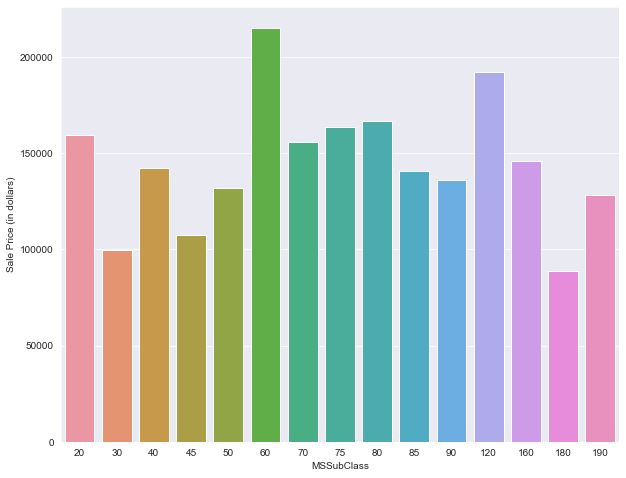

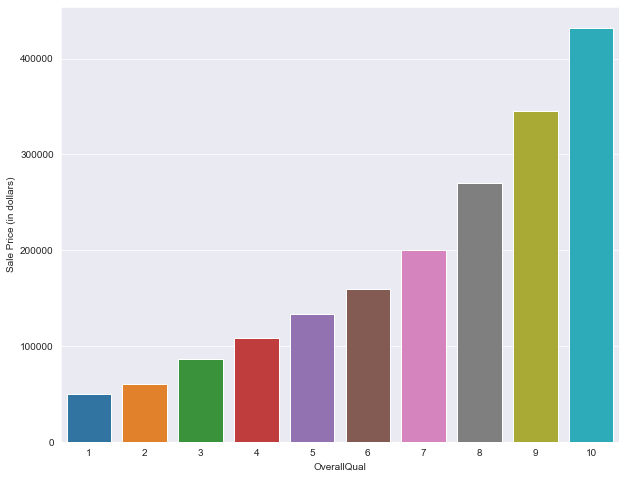

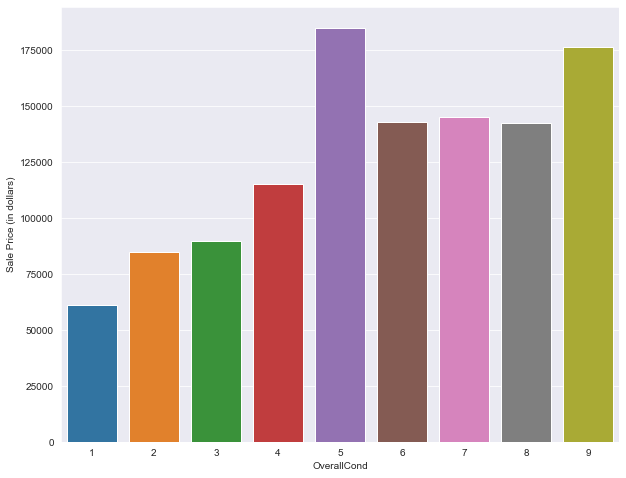

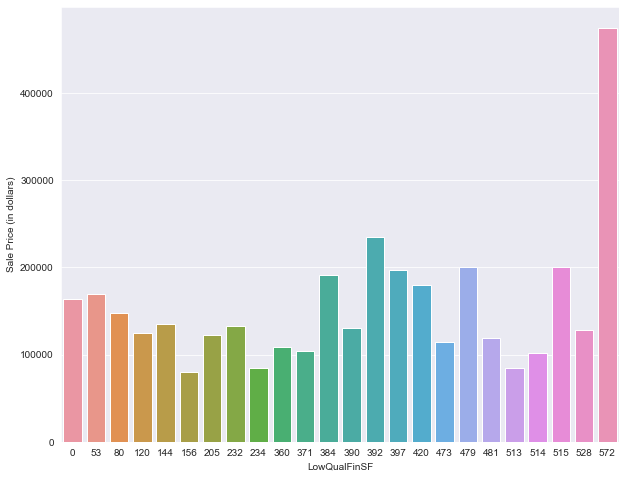

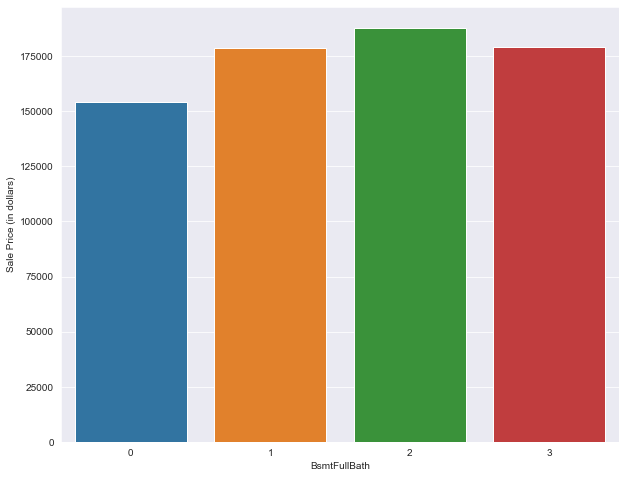

...

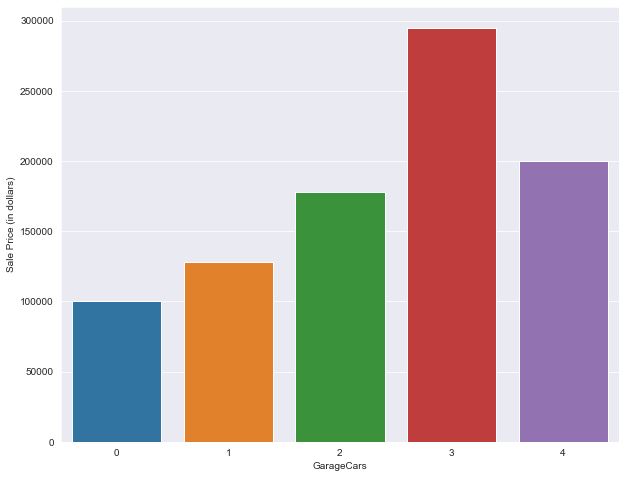

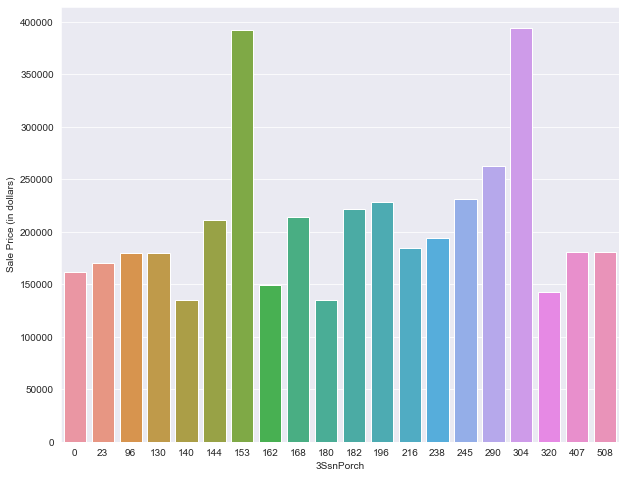

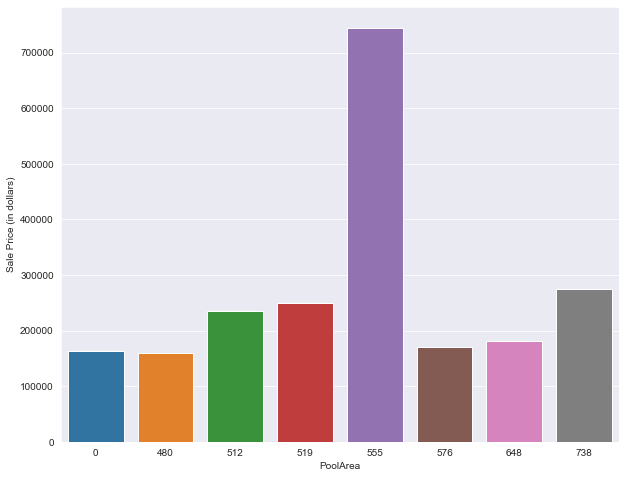

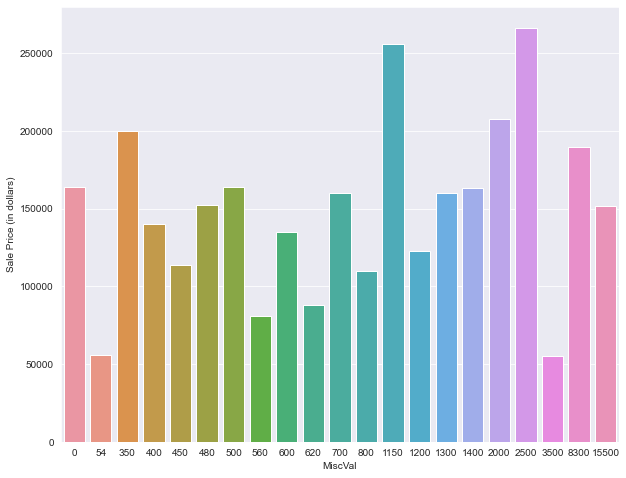

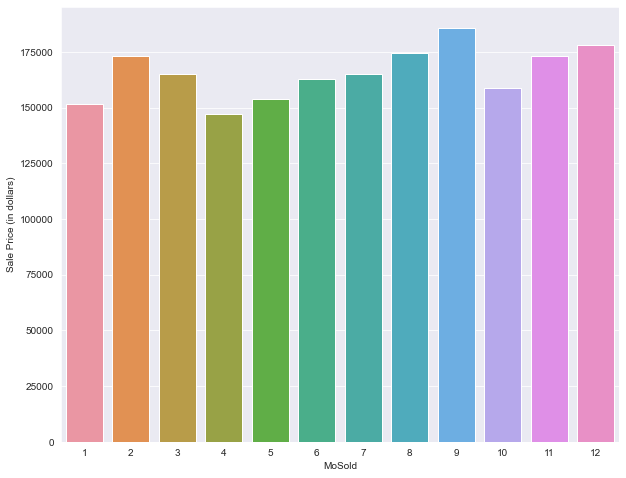

In [24]:
for feature in discrete_features:
    
    discrete_df = housing_df.groupby(feature).agg({'SalePrice':'median'})
    plt.figure(figsize=(10,8))
    sns.barplot(x = discrete_df.index, y= 'SalePrice', data =discrete_df )
    plt.ylabel('Sale Price (in dollars)')
    plt.xlabel(f"{feature}")
    plt.show()

-   For some of the mssubclass the sale price is high.
-   Overall qual/cond increases price increases.
-   More full bathrooms attract higher prices.


Now lets check for percentage of each category in discrete features.
If one of the categories is dominant then it can overshadow all other categories.

We will check for skewed categories and if found we will drop it.



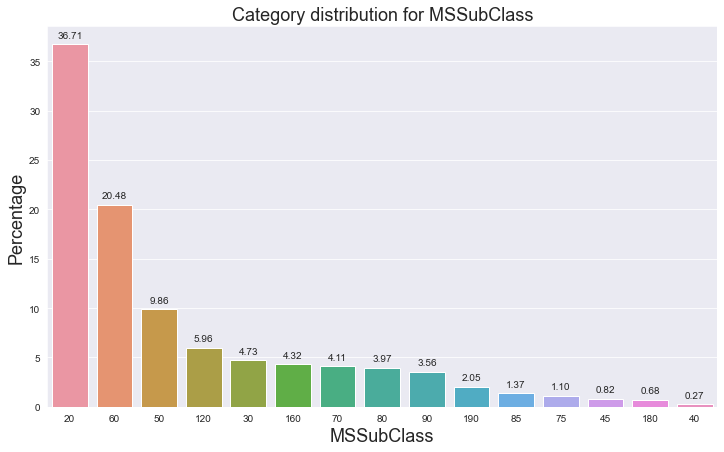

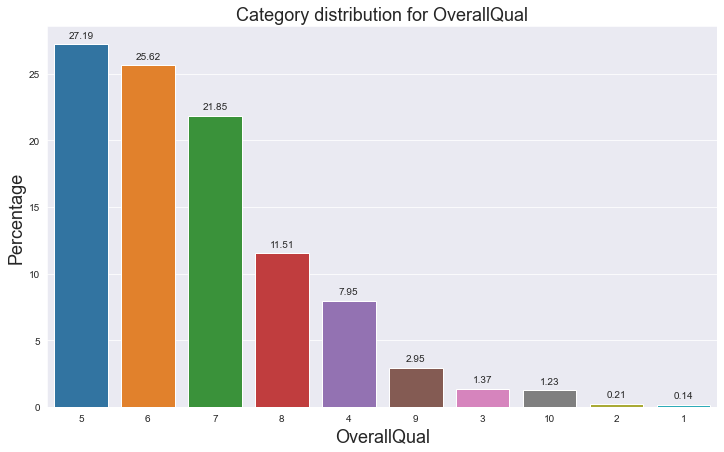

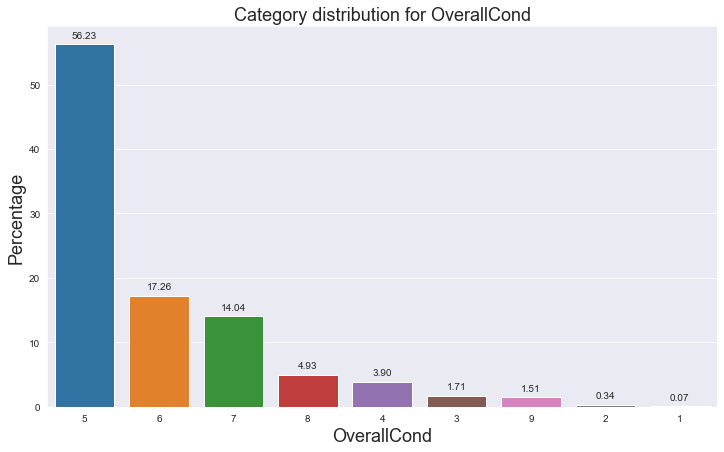

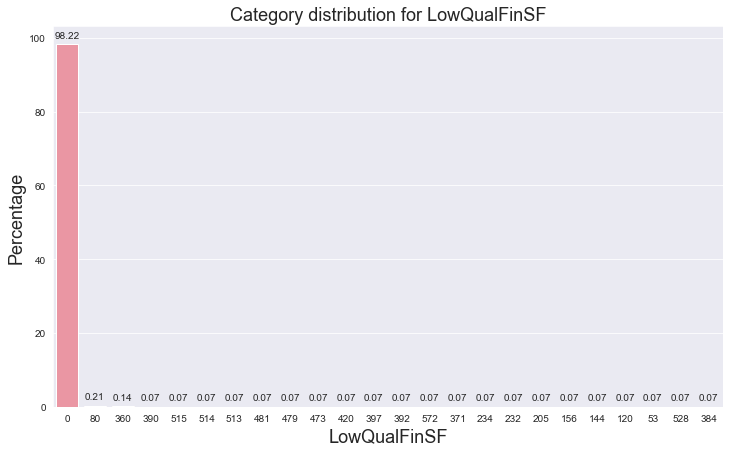

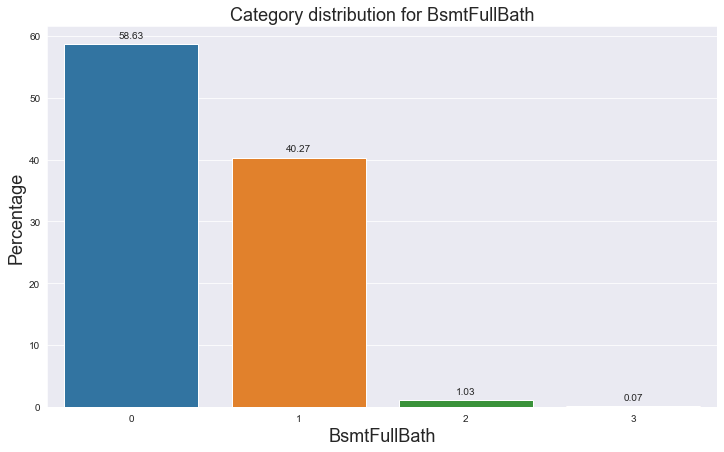

...

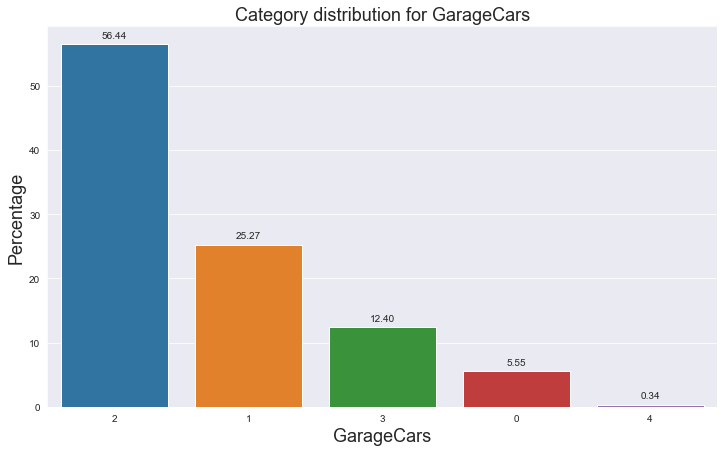

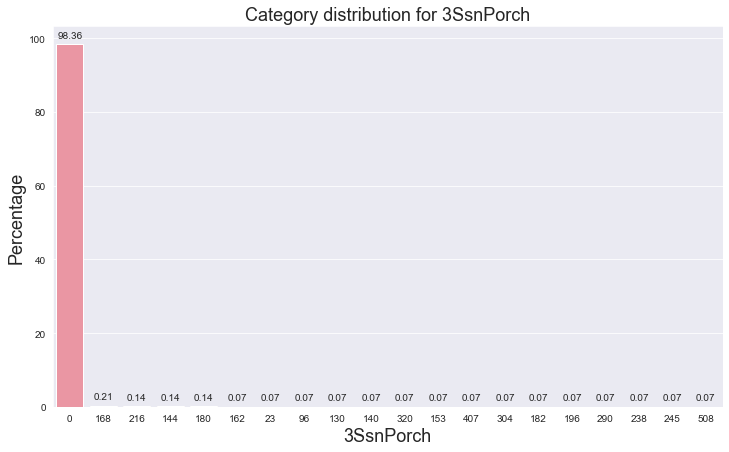

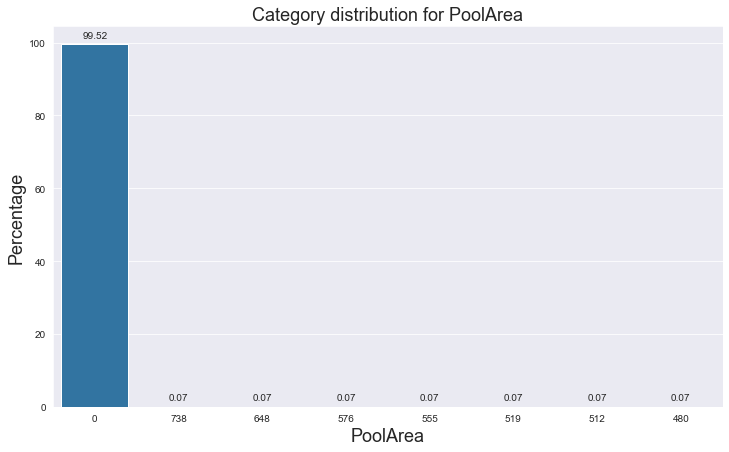

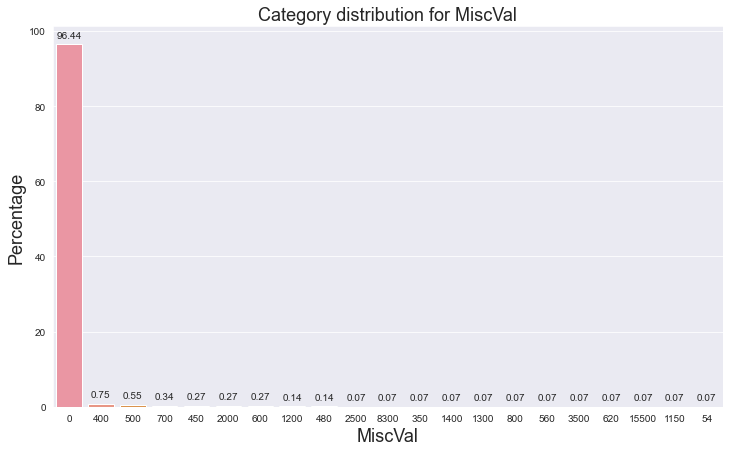

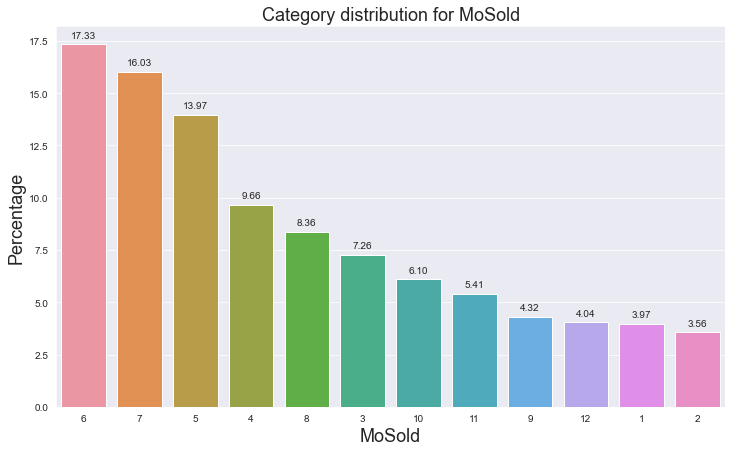

In [25]:
def plot_categories_for_feature(feature,rotate_xticks=False):
    
    temp = housing_df[feature].value_counts(normalize=True)*100
    temp_df = pd.DataFrame({'percentages':temp})
    temp_df.sort_values(by = 'percentages', inplace=True,ascending=False)

    # print(temp_df)

    plt.figure(figsize=(12,7))
    plt.title(f'Category distribution for {feature}',fontsize=18)
    splot =sns.barplot(x = temp_df.index , y = temp_df.percentages,order = temp_df.index)
    for p in splot.patches:
        splot.annotate(format(p.get_height(), '.2f'), 
                    (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', 
                    xytext = (0, 9), 
                    textcoords = 'offset points')
    plt.xlabel(feature,fontsize=18)
    if rotate_xticks:
        plt.xticks(rotation = 90)
    plt.ylabel('Percentage',fontsize=18)                
    plt.show()
    
for feature in discrete_features:
    plot_categories_for_feature(feature,)

_As is visible from the above plots some of the Discrete features like `LowQualFinSF`, `MiscVal`, `PoolArea`, `3SsnPorch`, `smtHalfBath`, `KitchenAbvGr`_ <br>
_have highly skewed category distribution. We should drop them as the dominant category can influence our model coefficients_

In [26]:
housing_df.drop(columns=['LowQualFinSF', 'MiscVal', 'PoolArea', '3SsnPorch', 'BsmtHalfBath', 'KitchenAbvGr'],inplace=True)
num_features_df.drop(columns=['LowQualFinSF', 'MiscVal', 'PoolArea', '3SsnPorch', 'BsmtHalfBath', 'KitchenAbvGr'],inplace=True)

In [27]:
# We will also remove the same columns from our discrete columns list to keep things consistent moving forward
for feature in ['LowQualFinSF', 'MiscVal', 'PoolArea', '3SsnPorch', 'BsmtHalfBath', 'KitchenAbvGr']:
    discrete_features.remove(feature)

#### Continous Features 

Let's check the correlations among the continous numerical features.

In [28]:
continous_features = [feature for feature in num_features_df.columns \
                        if feature not in year_features+discrete_features ]

print(f'The Continous features are: {continous_features}')

The Continous features are: ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'ScreenPorch', 'SalePrice']


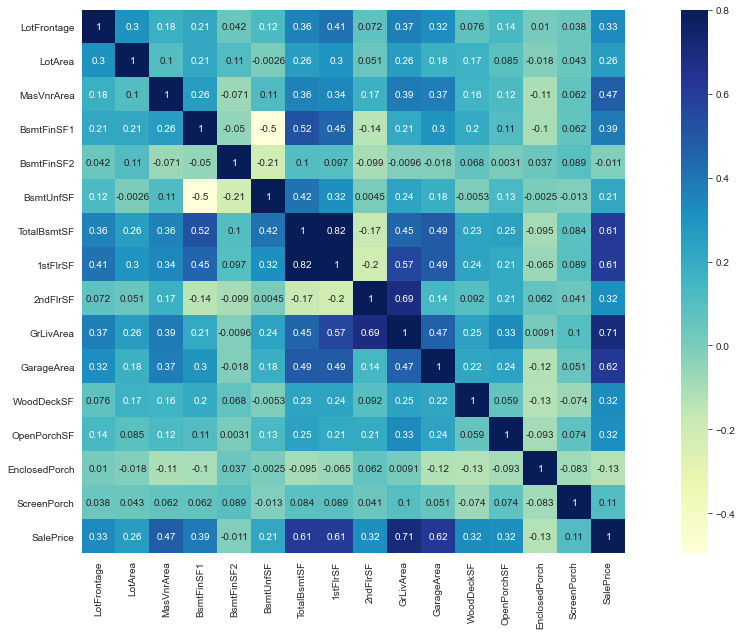

In [29]:
plt.figure(figsize=(20,10))
correlations = num_features_df[continous_features].corr()
sns.heatmap(correlations,annot=True,vmax=.8,cmap='YlGnBu',square=True)
plt.show()

We can clearly see some of the features are having high correlation with the SalePrice. <br>
Some of the features are GarageArea, 2ndFlrSF, TotalBsmtSF etc.
Lets check them in a more detailed manner. 

We can also see that some of the independent variables are correlated with each other.<br>
This multicollinearity can cause issues while model building and we have to drop some of them.

Lets check the top 10 correlated variables.

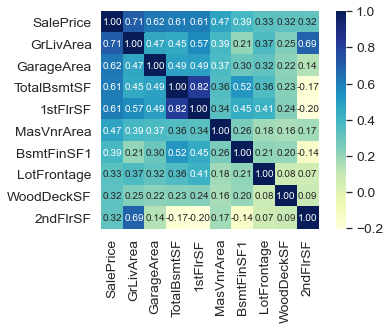

In [30]:
cols = correlations.nlargest(10, 'SalePrice')['SalePrice'].index
correlations_top_10 = np.corrcoef(housing_df[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(correlations_top_10, cbar=True,cmap='YlGnBu', annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

<Figure size 72x720 with 0 Axes>

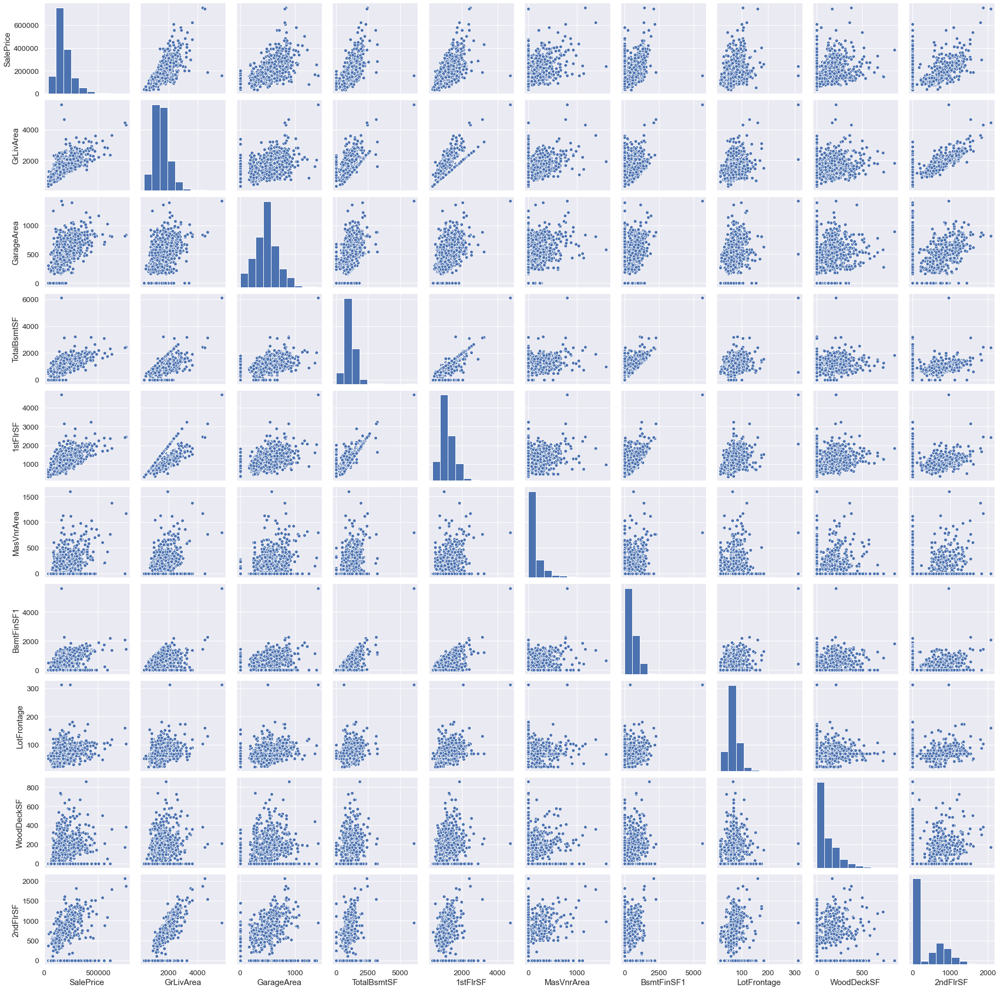

In [31]:
# Pair Plot to check of feature relationship with the target variable and also with one another
plt.figure(figsize=(1,10))
sns.pairplot(housing_df[cols])
plt.show()

If we look at scatter plots w.r.t SalePrice, most of the features are somewhat having linear relationship with SalePrice. <br>
Also the histograms of some of the features appear to be skewed. So will have to treat them before modelling.

#### Categorical Features vs SalePrice

Lets check how determinant each of the categories in the Categorical columns are for defining the SalePrice. 

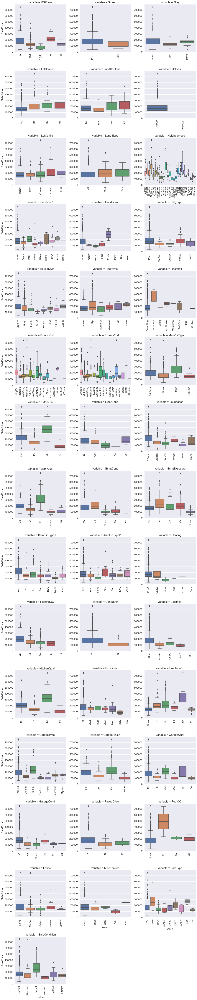

In [32]:
def boxplot(x, y, **kwargs):
    sns.boxplot(x=x, y=y)
    x=plt.xticks(rotation=90)
f = pd.melt(housing_df, id_vars=['SalePrice'], value_vars=categorical_features_df.columns)
g = sns.FacetGrid(f, col="variable",  col_wrap=3, sharex=False, sharey=False, size=5)
g = g.map(boxplot, "value", "SalePrice")

In [33]:
# lets check the number of categories per categrorical feature
for feature in categorical_features_df.columns:
    print(f'Number of Categories for feature {feature} are {len(categorical_features_df[feature].unique())}')

Number of Categories for feature MSZoning are 5
Number of Categories for feature Street are 2
Number of Categories for feature Alley are 3
Number of Categories for feature LotShape are 4
Number of Categories for feature LandContour are 4
Number of Categories for feature Utilities are 2
Number of Categories for feature LotConfig are 5
Number of Categories for feature LandSlope are 3
Number of Categories for feature Neighborhood are 25
Number of Categories for feature Condition1 are 9
Number of Categories for feature Condition2 are 8
Number of Categories for feature BldgType are 5
Number of Categories for feature HouseStyle are 8
Number of Categories for feature RoofStyle are 6
Number of Categories for feature RoofMatl are 8
Number of Categories for feature Exterior1st are 15
Number of Categories for feature Exterior2nd are 16
Number of Categories for feature MasVnrType are 4
Number of Categories for feature ExterQual are 4
Number of Categories for feature ExterCond are 5
Number of Categ

There are a few features with more than 15 categories, we need a proper way to handle these.

We will check for categorical features with Rare Categories or with any Skewed Categories.

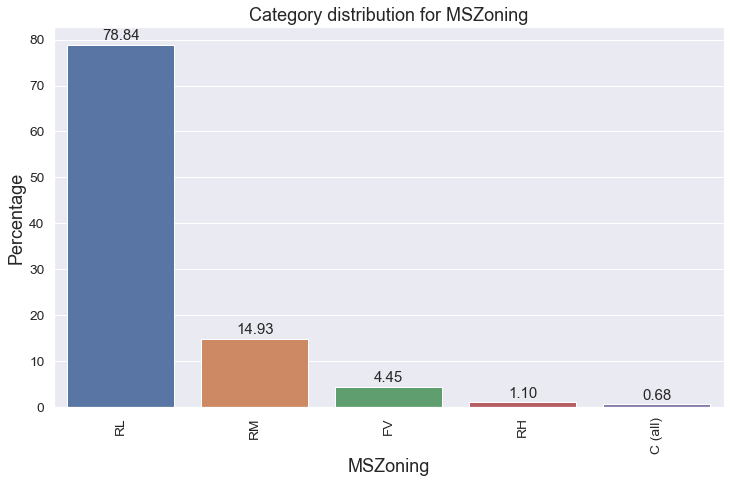

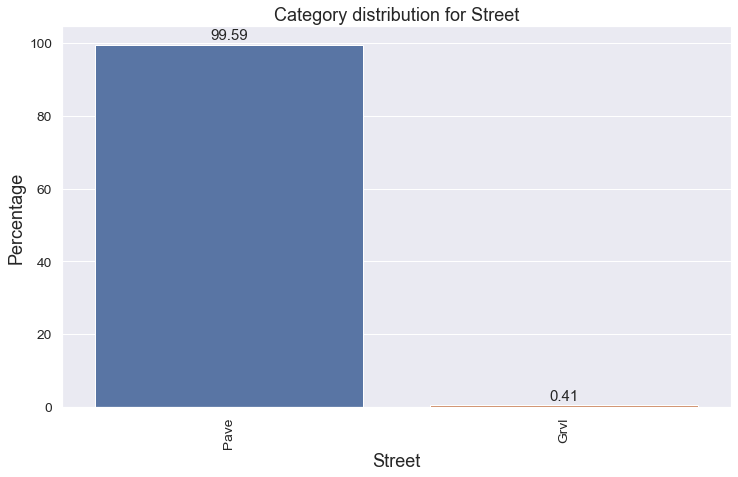

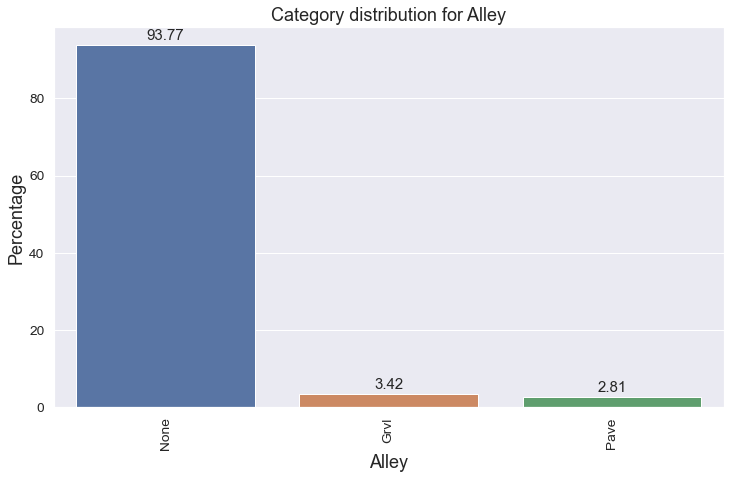

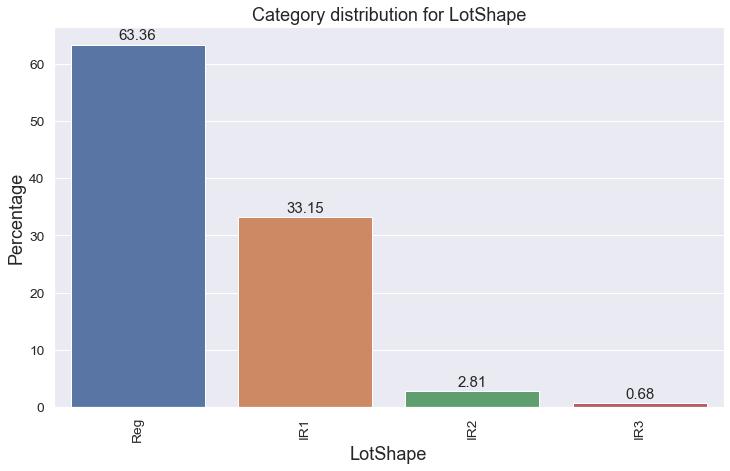

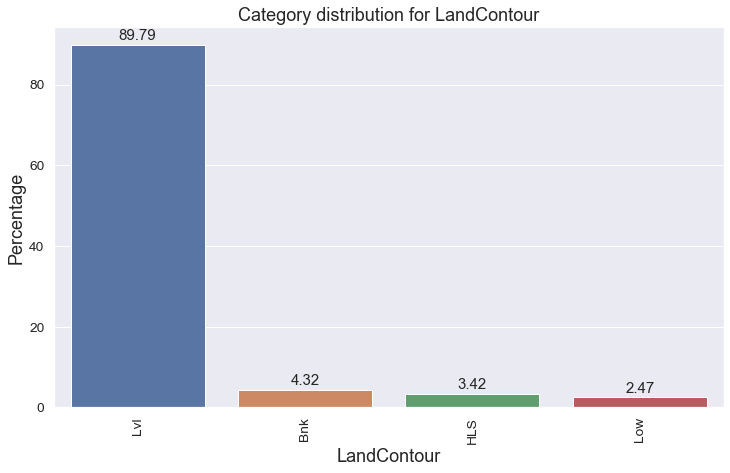

...

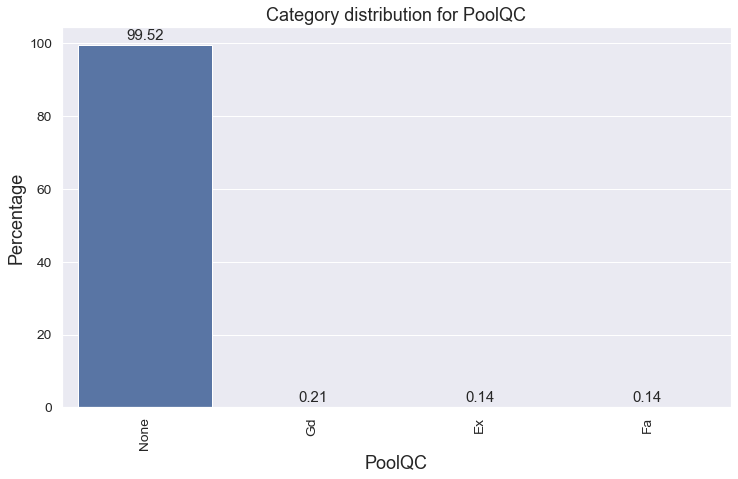

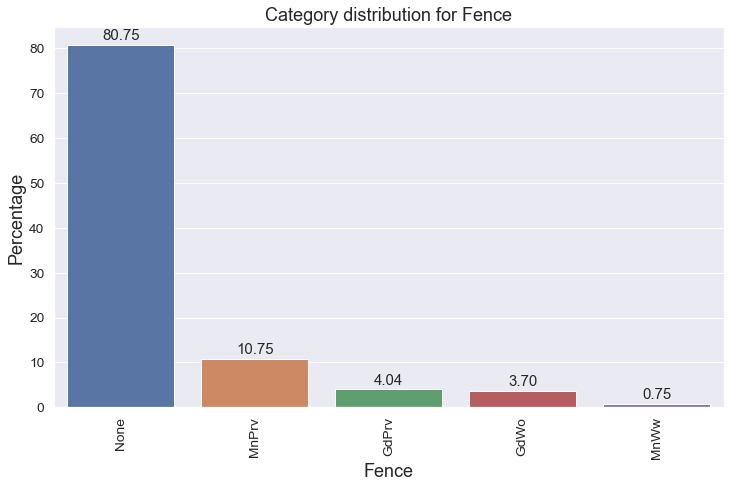

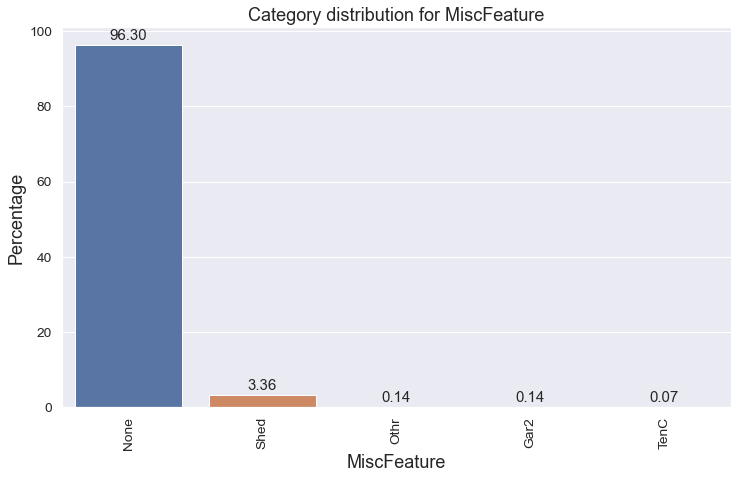

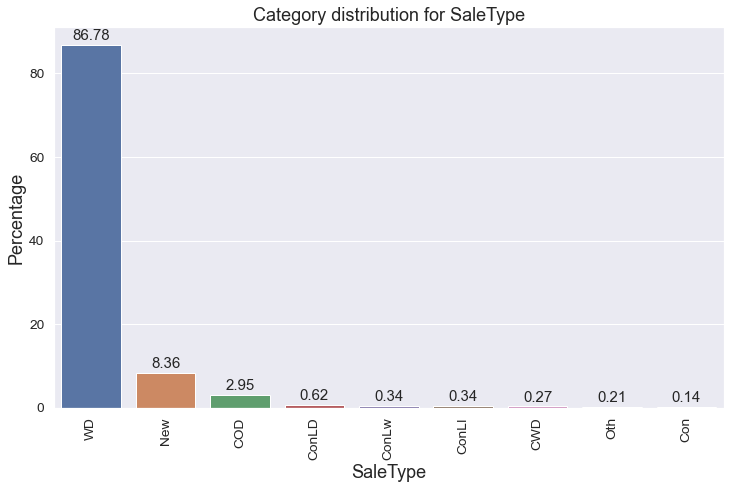

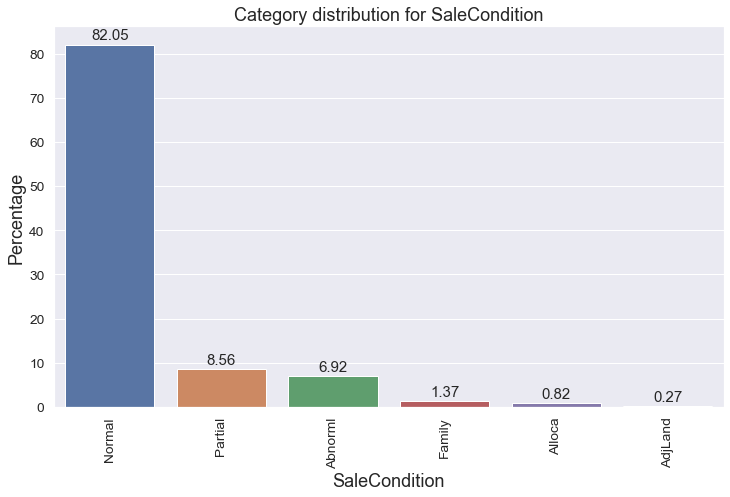

In [34]:
for feature in categorical_features_df.columns:
    plot_categories_for_feature(feature,rotate_xticks=True)

As we have already handled the skewed discrete features we will also handle the Categorical features in a similar fashion.<br>
We will drop the following columns because of skewed categories: <br>

1. MiscFeature
2. PoolQC
3. Heating
4. Condition2
5. RoofMatl
6. Street
7. Utilities

In [35]:
housing_df.drop(columns=['MiscFeature','PoolQC','Heating','Condition2','RoofMatl','Street','Utilities'],inplace=True)
categorical_features_df.drop(columns=['MiscFeature','PoolQC','Heating','Condition2','RoofMatl','Street','Utilities'],inplace=True)

In [36]:
# Update list of categorical features
categorical_features = [feature for feature in categorical_features_df.columns]

Now we will club the categories with less 1% observations into a new category called `RARE_CATEGORY`.

In [37]:
for feature in categorical_features:
    temp = housing_df[feature].value_counts(normalize=True)
    temp_df = pd.DataFrame({'percentages':temp})
    selected_categories_to_keep = temp_df[temp_df.percentages>0.01].index 
    housing_df[feature] = np.where(housing_df[feature].isin(selected_categories_to_keep),housing_df[feature],'RARE_CATEGORY')

Now lets check the number of categories after streamlining.

In [38]:
# lets check the number of categories per categrorical feature
for feature in categorical_features:
    print(f'Number of Categories for feature {feature} are {len(housing_df[feature].unique())}')

Number of Categories for feature MSZoning are 5
Number of Categories for feature Alley are 3
Number of Categories for feature LotShape are 4
Number of Categories for feature LandContour are 4
Number of Categories for feature LotConfig are 5
Number of Categories for feature LandSlope are 3
Number of Categories for feature Neighborhood are 23
Number of Categories for feature Condition1 are 6
Number of Categories for feature BldgType are 5
Number of Categories for feature HouseStyle are 6
Number of Categories for feature RoofStyle are 3
Number of Categories for feature Exterior1st are 11
Number of Categories for feature Exterior2nd are 11
Number of Categories for feature MasVnrType are 4
Number of Categories for feature ExterQual are 4
Number of Categories for feature ExterCond are 4
Number of Categories for feature Foundation are 5
Number of Categories for feature BsmtQual are 5
Number of Categories for feature BsmtCond are 5
Number of Categories for feature BsmtExposure are 5
Number of 

### Outliers

Now presence of Outliers can influence our model coefficients which will impact our model predictions.<br>
As linear regression cannot extrapolate, so if we remove the outliers the model would not be able to <br>
predict values that lie in the range of the outliers.

The best way to handle this would be to do a log transformation on the target variable.


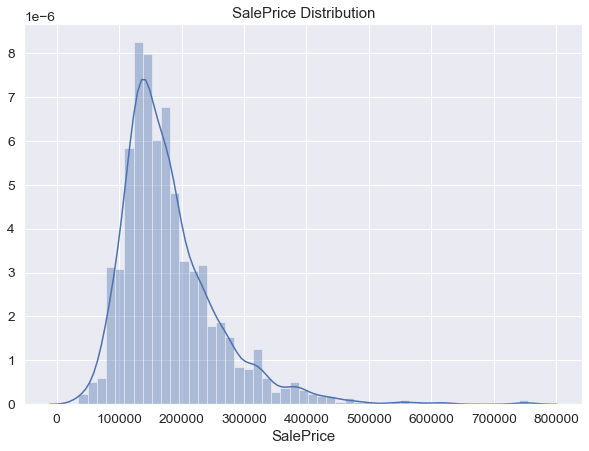

In [39]:
# Lets check the distribution of the target variable
def show_distribution(feature):
    plt.figure(figsize=(10,7))
    plt.title(f'{feature} Distribution')
    sns.distplot(housing_df[feature])
    plt.show()

show_distribution('SalePrice')

We can see that the SalePrice feature has some positive skew and has outliers.<br>
In order to avoid issues explained above, we will take a Log Transformation of the target column.

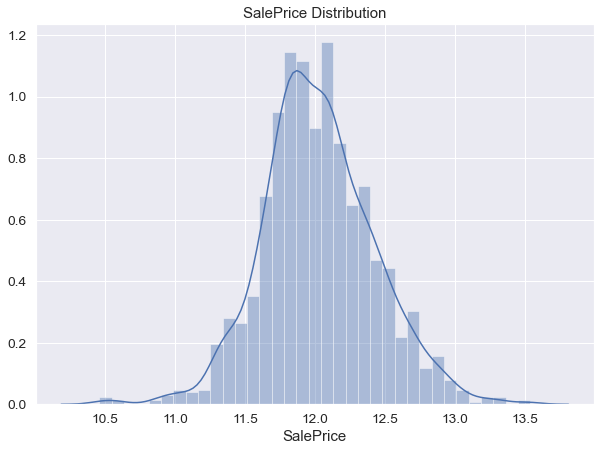

In [40]:
housing_df['SalePrice'] = np.log(housing_df.SalePrice)
show_distribution('SalePrice')

Now we can see that the skewness is under control.

## Feature Engineering

We will build some interesting features from the existing featureset which will help in model building.

#### Remove Correlated Features

We will remove correlated features that provide the same information.
For this we will use the correlation matrix and remove the features which have a high correlation among them.

In [41]:
correlated_features = set()
correlation_matrix = housing_df[continous_features].drop('SalePrice', axis=1).corr()

for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.7:
            colname = correlation_matrix.columns[i]
            correlated_features.add(colname)

In [42]:
print(f'The correlated features that need to be removed: {list(correlated_features)}')

The correlated features that need to be removed: ['1stFlrSF']


In [43]:
housing_df.drop(list(correlated_features),axis=1,inplace=True)

In [44]:
for feature in list(correlated_features):
    continous_features.remove(feature)

####  Adding `Age` feature for year columns


In [45]:
for feature in year_features:
    if feature != 'YrSold':
        housing_df[f'Age_{feature}'] = housing_df['YrSold'] - housing_df[feature]

In [46]:
housing_df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,Electrical,2ndFlrSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,Fence,MoSold,YrSold,SaleType,SaleCondition,SalePrice,Age_YearBuilt,Age_YearRemodAdd,Age_GarageYrBlt
0,60,RL,65.0,8450,None,Reg,Lvl,Inside,Gtl,CollgCr,Norm,1Fam,2Story,7,5,2003,2003,Gable,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,Ex,Y,SBrkr,854,1710,1,2,1,3,Gd,8,Typ,0,None,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,None,2,2008,WD,Normal,12.247694,5,5,5.0
1,20,RL,80.0,9600,None,Reg,Lvl,FR2,Gtl,RARE_CATEGORY,Feedr,1Fam,1Story,6,8,1976,1976,Gable,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,Ex,Y,SBrkr,0,1262,0,2,0,3,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,None,5,2007,WD,Normal,12.109011,31,31,31.0
2,60,RL,68.0,11250,None,IR1,Lvl,Inside,Gtl,CollgCr,Norm,1Fam,2Story,7,5,2001,2002,Gable,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,Ex,Y,SBrkr,866,1786,1,2,1,3,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,None,9,2008,WD,Normal,12.317167,7,6,7.0
3,70,RL,60.0,9550,None,IR1,Lvl,Corner,Gtl,Crawfor,Norm,1Fam,2Story,7,5,1915,1970,Gable,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,Gd,Y,SBrkr,756,1717,1,1,0,3,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,None,2,2006,WD,Abnorml,11.849398,91,36,8.0
4,60,RL,84.0,14260,None,IR1,Lvl,FR2,Gtl,NoRidge,Norm,1Fam,2Story,8,5,2000,2000,Gable,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,Ex,Y,SBrkr,1053,2198,1,2,1,4,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,None,12,2008,WD,Normal,12.429216,8,8,8.0


In [47]:
# we will drop the original temporal features 
housing_df.drop(columns=year_features,inplace=True)

#### Handle Categorical Variables

As our model will only understand numerical values, we need to convert all the categories to numeric equivalents.<br>

In [48]:
# Create dummy variables and drop original columns
final_categorical_encoded = pd.get_dummies(housing_df,columns=categorical_features,drop_first=True)

In [49]:
final_categorical_encoded.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,2ndFlrSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,ScreenPorch,MoSold,SalePrice,Age_YearBuilt,Age_YearRemodAdd,Age_GarageYrBlt,MSZoning_RARE_CATEGORY,MSZoning_RH,MSZoning_RL,MSZoning_RM,Alley_None,Alley_Pave,LotShape_IR2,LotShape_RARE_CATEGORY,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_Inside,LotConfig_RARE_CATEGORY,LandSlope_Mod,LandSlope_RARE_CATEGORY,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_RARE_CATEGORY,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Condition1_Feedr,Condition1_Norm,Condition1_PosN,Condition1_RARE_CATEGORY,Condition1_RRAn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1Story,HouseStyle_2Story,HouseStyle_RARE_CATEGORY,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Hip,RoofStyle_RARE_CATEGORY,Exterior1st_BrkFace,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_RARE_CATEGORY,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_BrkFace,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_MetalSd,Exterior2nd_Plywood,Exterior2nd_RARE_CATEGORY,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Gd,ExterQual_RARE_CATEGORY,ExterQual_TA,ExterCond_Gd,ExterCond_RARE_CATEGORY,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_RARE_CATEGORY,Foundation_Slab,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_RARE_CATEGORY,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_RARE_CATEGORY,BsmtFinType2_Rec,BsmtFinType2_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_RARE_CATEGORY,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_RARE_CATEGORY,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Min2,Functional_Mod,Functional_RARE_CATEGORY,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Basment,GarageType_BuiltIn,GarageType_Detchd,GarageType_None,GarageType_RARE_CATEGORY,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_None,GarageQual_RARE_CATEGORY,GarageQual_TA,GarageCond_None,GarageCond_RARE_CATEGORY,GarageCond_TA,PavedDrive_P,PavedDrive_Y,Fence_GdWo,Fence_MnPrv,Fence_None,Fence_RARE_CATEGORY,SaleType_New,SaleType_RARE_CATEGORY,SaleType_WD,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial,SaleCondition_RARE_CATEGORY
0,60,65.0,8450,7,5,196.0,706,0,150,856,854,1710,1,2,1,3,8,0,2,548,0,61,0,0,2,12.247694,5,5,5.0,0,0,1,0,1,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,0,0,0,1,0,1,0,0
1,20,80.0,9600,6,8,0.0,978,0,284,1262,0,1262,0,2,0,3,6,1,2,460,298,0,0,0,5,12.109011,31,31,31.0,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,1,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,

In [50]:
final_categorical_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Columns: 189 entries, MSSubClass to SaleCondition_RARE_CATEGORY
dtypes: float64(4), int64(25), uint8(160)
memory usage: 559.0 KB


After handling categorical variables we have `189 features`.

#### Split into train and test sets

We will now split our data into training and testing sets for modelling

In [51]:
features_to_be_scaled = [feature for feature in discrete_features+continous_features if feature not in year_features and feature != 'SalePrice']

In [52]:
y = final_categorical_encoded.pop('SalePrice')
X = final_categorical_encoded

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.33, random_state=42)

#### Scaling

We will need to scale our features if we want to interpret our model.<br>
Having scaled features will result into scaled coefficients which makes it easy to understand a features effects on the Target.

In [53]:
scaler = MinMaxScaler()
X_train[features_to_be_scaled] = scaler.fit_transform(X_train[features_to_be_scaled])
X_test[features_to_be_scaled]=scaler.transform(X_test[features_to_be_scaled])

## Modelling 

We will first create our Baseline models with all features using

1. Linear Regression
2. Lasso 
3. Ridge 

Then we will peform RFE, followed by feature selection using p-value and VIF.<br>
We can then use the remaining features to create Ridge/Lasso models and perform hyperparameter tuning.


In [54]:
# linear regression
lm = LinearRegression()
lasso_model = Lasso()
ridge_model = Ridge()

In [55]:
def fit_evalaute_one_model(model,X_train,X_test,y_train,y_test):
    
    scores = {}
    model.fit(X_train,y_train)

    y_train_preds = model.predict(X_train)
    training_r2 = r2_score(y_true=y_train, y_pred=y_train_preds)

    y_test_preds = model.predict(X_test)
    testing_r2 = r2_score(y_true=y_test, y_pred=y_test_preds)

    scores['model'] = str(model.__class__).split('.')[-1][:-2]
    scores['training_r2'] = training_r2
    scores['testing_r2'] = testing_r2
    

    return model,scores



In [56]:
def fit_evalaute_models(model_list,X_train,X_test,y_train,y_test):


    scores_df = pd.DataFrame()
    for model in model_list:
        _,scores = fit_evalaute_one_model(model,X_train,X_test,y_train,y_test)
        print(scores)
        scores_df = scores_df.append(scores,ignore_index=True)

    return scores_df

scores_df = fit_evalaute_models([lm,lasso_model,ridge_model],X_train,X_test,y_train,y_test)

{'model': 'LinearRegression', 'training_r2': 0.9223680324343452, 'testing_r2': 0.8786831165473147}
{'model': 'Lasso', 'training_r2': 0.3968541213752087, 'testing_r2': 0.40567573209273855}
{'model': 'Ridge', 'training_r2': 0.9202123793632041, 'testing_r2': 0.8758781380350928}


In [57]:
# Scores for all models
scores_df.head()

,model,testing_r2,training_r2
0,LinearRegression,0.878683,0.922368
1,Lasso,0.405676,0.396854
2,Ridge,0.875878,0.920212


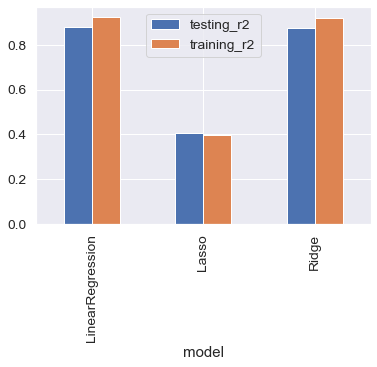

In [58]:
scores_df.plot(x="model", y=["testing_r2", "training_r2"], kind="bar")

By using all 189 features and using default/arbitrary alpha value in Lasso and Ridge we get a r2 score of 40 - 94 % on training set and around 41 - 87% on testing set.<br>
Clearly there is some amount of overfitting that can be observed.

Also the models were built using default/arbitrary alpha values for Lasso and Ridge.

We will try to find the optimal value of alpha using Cross Validation schemes which will also help us produce a more generalizable model.


## Feature Selection

### RFE

As we have 189 features, we will start with 70 features using RFE.

In [59]:
lm = LinearRegression()
lm.fit(X_train, y_train)

rfe = RFE(lm, 70)             # running RFE
rfe = rfe.fit(X_train, y_train)

In [60]:
list(zip(X_train.columns,rfe.support_,rfe.ranking_))

[('MSSubClass', True, 1),
 ('LotFrontage', True, 1),
 ('LotArea', True, 1),
 ('OverallQual', True, 1),
 ('OverallCond', True, 1),
 ('MasVnrArea', False, 74),
 ('BsmtFinSF1', True, 1),
 ('BsmtFinSF2', True, 1),
 ('BsmtUnfSF', True, 1),
 ('TotalBsmtSF', True, 1),
 ('2ndFlrSF', True, 1),
 ('GrLivArea', True, 1),
 ('BsmtFullBath', True, 1),
 ('FullBath', True, 1),
 ('HalfBath', True, 1),
 ('BedroomAbvGr', False, 7),
 ('TotRmsAbvGrd', True, 1),
 ('Fireplaces', False, 94),
 ('GarageCars', True, 1),
 ('GarageArea', False, 72),
 ('WoodDeckSF', True, 1),
 ('OpenPorchSF', False, 71),
 ('EnclosedPorch', True, 1),
 ('ScreenPorch', True, 1),
 ('MoSold', False, 45),
 ('Age_YearBuilt', False, 113),
 ('Age_YearRemodAdd', False, 109),
 ('Age_GarageYrBlt', False, 118),
 ('MSZoning_RARE_CATEGORY', True, 1),
 ('MSZoning_RH', False, 66),
 ('MSZoning_RL', False, 68),
 ('MSZoning_RM', False, 42),
 ('Alley_None', False, 46),
 ('Alley_Pave', True, 1),
 ('LotShape_IR2', False, 20),
 ('LotShape_RARE_CATEGORY', T

In [61]:
not_selected_cols = X_train.columns[~rfe.support_]
print(f'The unselected columns after RFE are: {list(not_selected_cols)}') 

The unselected columns after RFE are: ['MasVnrArea', 'BedroomAbvGr', 'Fireplaces', 'GarageArea', 'OpenPorchSF', 'MoSold', 'Age_YearBuilt', 'Age_YearRemodAdd', 'Age_GarageYrBlt', 'MSZoning_RH', 'MSZoning_RL', 'MSZoning_RM', 'Alley_None', 'LotShape_IR2', 'LotShape_Reg', 'LotConfig_CulDSac', 'LotConfig_FR2', 'LotConfig_Inside', 'LotConfig_RARE_CATEGORY', 'LandSlope_Mod', 'LandSlope_RARE_CATEGORY', 'Neighborhood_BrDale', 'Neighborhood_BrkSide', 'Neighborhood_CollgCr', 'Neighborhood_Gilbert', 'Neighborhood_Mitchel', 'Neighborhood_NAmes', 'Neighborhood_NWAmes', 'Neighborhood_RARE_CATEGORY', 'Neighborhood_SWISU', 'Neighborhood_Sawyer', 'Neighborhood_SawyerW', 'Neighborhood_Somerst', 'Neighborhood_Timber', 'Condition1_Feedr', 'Condition1_PosN', 'Condition1_RARE_CATEGORY', 'Condition1_RRAn', 'BldgType_2fmCon', 'BldgType_TwnhsE', 'HouseStyle_1Story', 'HouseStyle_2Story', 'HouseStyle_RARE_CATEGORY', 'HouseStyle_SFoyer', 'HouseStyle_SLvl', 'RoofStyle_Hip', 'RoofStyle_RARE_CATEGORY', 'Exterior1st_C

In [62]:
col = X_train.columns[rfe.support_]
print(f'The selected columns after RFE are: {list(col)}')

The selected columns after RFE are: ['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'TotRmsAbvGrd', 'GarageCars', 'WoodDeckSF', 'EnclosedPorch', 'ScreenPorch', 'MSZoning_RARE_CATEGORY', 'Alley_Pave', 'LotShape_RARE_CATEGORY', 'LandContour_HLS', 'LandContour_Low', 'LandContour_Lvl', 'Neighborhood_ClearCr', 'Neighborhood_Crawfor', 'Neighborhood_Edwards', 'Neighborhood_IDOTRR', 'Neighborhood_MeadowV', 'Neighborhood_NoRidge', 'Neighborhood_NridgHt', 'Neighborhood_OldTown', 'Neighborhood_StoneBr', 'Condition1_Norm', 'BldgType_Duplex', 'BldgType_Twnhs', 'Exterior1st_BrkFace', 'Exterior1st_MetalSd', 'Exterior1st_Stucco', 'Exterior1st_Wd Sdng', 'Exterior2nd_MetalSd', 'Exterior2nd_Wd Sdng', 'Foundation_PConc', 'BsmtQual_Fa', 'BsmtQual_Gd', 'BsmtQual_None', 'BsmtQual_TA', 'BsmtCond_None', 'BsmtCond_RARE_CATEGORY', 'BsmtExposure_Gd', 'BsmtExposure_None', 

In [63]:
# Extract features selected by RFE
X_train_rfe = X_train[col]

In [64]:
def fit_linear_model(df,labels):
    '''
     This function adds a constant to the input DF and 
     fits OLS model
    '''
    df_with_const = sm.add_constant(df)
    lm = sm.OLS(labels,df_with_const).fit()   # Running the linear model
    return lm 

def get_vif_for_features(df):
    '''
    This function creates a dataframe of VIF values and sorts in Descending order
    '''
    vif = pd.DataFrame()
    vif['Features'] = df.columns
    vif['VIF'] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
    vif['VIF'] = round(vif['VIF'], 2)
    vif = vif.sort_values(by = "VIF", ascending = False)
    return vif

In [65]:
# Fit the linear OLS model and get summary statistics
model = None

def show_model_statistics(features,labels):
    global model
    model = fit_linear_model(features,labels)
    print(model.summary())
    print()
    print('='*100)
    print()
    # Print the VIF for the selected features
    print('Variance Inflation Factor of Features')
    print('-'*50)
    print(get_vif_for_features(X_train_rfe))

show_model_statistics(features=X_train_rfe, labels=y_train)

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.902
Model:                            OLS   Adj. R-squared:                  0.895
Method:                 Least Squares   F-statistic:                     135.8
Date:                Sun, 20 Dec 2020   Prob (F-statistic):               0.00
Time:                        23:08:34   Log-Likelihood:                 663.02
No. Observations:                 978   AIC:                            -1200.
Df Residuals:                     915   BIC:                            -892.3
Df Model:                          62                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

`BsmtUnfSF` has a high p-value and it is insignificant in the presence of other variables, we will remove this and refit the model again and check the summary statistics.

In [66]:
X_train_rfe = X_train_rfe.drop(['BsmtUnfSF'], axis=1)
show_model_statistics(features=X_train_rfe, labels=y_train)

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.902
Model:                            OLS   Adj. R-squared:                  0.895
Method:                 Least Squares   F-statistic:                     135.8
Date:                Sun, 20 Dec 2020   Prob (F-statistic):               0.00
Time:                        23:08:36   Log-Likelihood:                 663.02
No. Observations:                 978   AIC:                            -1200.
Df Residuals:                     915   BIC:                            -892.3
Df Model:                          62                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

`BsmtFinSF2` has a high p-value and it is insignificant in the presence of other variables, we will remove this and refit the model again and check the summary statistics.

In [67]:
X_train_rfe = X_train_rfe.drop(['BsmtFinSF2'], axis=1)
show_model_statistics(features=X_train_rfe, labels=y_train)

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.902
Model:                            OLS   Adj. R-squared:                  0.895
Method:                 Least Squares   F-statistic:                     138.2
Date:                Sun, 20 Dec 2020   Prob (F-statistic):               0.00
Time:                        23:08:37   Log-Likelihood:                 662.98
No. Observations:                 978   AIC:                            -1202.
Df Residuals:                     916   BIC:                            -899.1
Df Model:                          61                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

`BsmtCond_RARE_CATEGORY` has a high p-value and it is insignificant in the presence of other variables, we will remove this and refit the model again and check the summary statistics.

In [68]:
X_train_rfe = X_train_rfe.drop(['BsmtCond_RARE_CATEGORY'], axis=1)
show_model_statistics(features=X_train_rfe, labels=y_train)

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.902
Model:                            OLS   Adj. R-squared:                  0.896
Method:                 Least Squares   F-statistic:                     140.6
Date:                Sun, 20 Dec 2020   Prob (F-statistic):               0.00
Time:                        23:08:38   Log-Likelihood:                 662.70
No. Observations:                 978   AIC:                            -1203.
Df Residuals:                     917   BIC:                            -905.4
Df Model:                          60                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

Removing `GarageType_None` because of high VIF.

In [69]:
X_train_rfe = X_train_rfe.drop(['GarageType_None'], axis=1)
show_model_statistics(features=X_train_rfe, labels=y_train)

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.902
Model:                            OLS   Adj. R-squared:                  0.896
Method:                 Least Squares   F-statistic:                     140.6
Date:                Sun, 20 Dec 2020   Prob (F-statistic):               0.00
Time:                        23:08:39   Log-Likelihood:                 662.70
No. Observations:                 978   AIC:                            -1203.
Df Residuals:                     917   BIC:                            -905.4
Df Model:                          60                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

Removing `GarageFinish_None` because of high VIF.

In [70]:
X_train_rfe = X_train_rfe.drop(['GarageFinish_None'], axis=1) 
show_model_statistics(features=X_train_rfe, labels=y_train)

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.902
Model:                            OLS   Adj. R-squared:                  0.896
Method:                 Least Squares   F-statistic:                     140.6
Date:                Sun, 20 Dec 2020   Prob (F-statistic):               0.00
Time:                        23:08:40   Log-Likelihood:                 662.70
No. Observations:                 978   AIC:                            -1203.
Df Residuals:                     917   BIC:                            -905.4
Df Model:                          60                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

In [71]:
print(f'After using RFE and some amount of manual feature selection we have {len(X_train_rfe.columns)} features remaining.')

After using RFE and some amount of manual feature selection we have 65 features remaining.


## Hyperparameter Tuning 

In [72]:
# list of alphas to tune
params = {'alpha':[0.001, 0.001, 0.01, 0.1,1.0, 2.0, 3.0, 4.0, 5.0, 10.0,20.0]}

ridge = Ridge()
lasso = Lasso()

def tune_paramters_for_model(model,params,log_scale=False):

    # cross validation
    folds = KFold(n_splits=10,shuffle=True,random_state=42)
    model_cv = GridSearchCV(estimator = model, 
                            param_grid = params, 
                            scoring= 'r2', 
                            cv = folds, 
                            return_train_score=True,
                            verbose = 1)            
    model_cv.fit(X_train_rfe, y_train) 

    cv_results = pd.DataFrame(model_cv.cv_results_)
    cv_results = cv_results[cv_results['param_alpha']<=200]

    # plotting mean test and train scoes with alpha 
    cv_results['param_alpha'] = cv_results['param_alpha'].astype('int32')

    # plotting
    plt.figure(figsize=(10,7))
    plt.plot(cv_results['param_alpha'], cv_results['mean_train_score'])
    plt.plot(cv_results['param_alpha'], cv_results['mean_test_score'])
    plt.xlabel('alpha')
    plt.ylabel('R2 Score')
    plt.title(f"Negative Mean Absolute Error and alpha for {str(model.__class__).split('.')[-1][:-2]} Model")
    plt.legend(['train score', 'test score'], loc='upper right')
    if log_scale:
        plt.xscale('log')

    plt.show()

    return cv_results,model_cv

Fitting 10 folds for each of 11 candidates, totalling 110 fits
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 110 out of 110 | elapsed:    0.8s finished


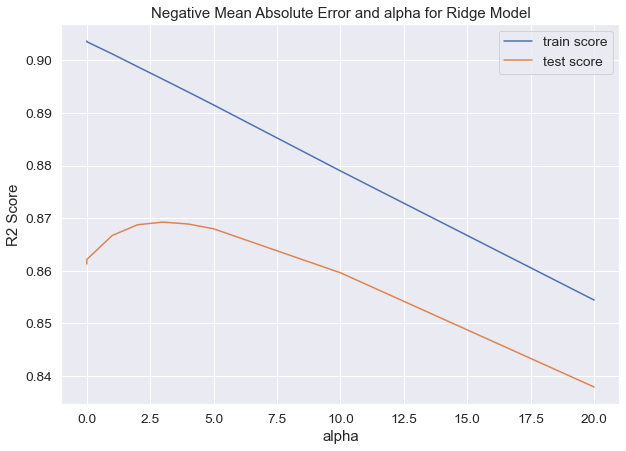

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.003802,0.000875,0.002000,0.000450,0,{'alpha': 0.001},0.884109,0.927075,0.635336,0.863510,0.930039,0.807291,0.857650,0.918451,0.896937,0.892500,0.861290,0.083112,8,0.902481,0.898180,0.915444,0.904918,0.897866,0.909474,0.906276,0.899342,0.901401,0.901263,0.903664,0.005250
1,0.003403,0.000806,0.001696,0.000461,0,{'alpha': 0.001},0.884109,0.927075,0.635336,0.863510,0.930039,0.807291,0.857650,0.918451,0.896937,0.892500,0.861290,0.083112,8,0.902481,0.898180,0.915444,0.904918,0.897866,0.909474,0.906276,0.899342,0.901401,0.901263,0.903664,0.005250
2,0.003800,0.000600,0.001999,0.000633,0,{'alpha': 0.01},0.884018,0.926960,0.635629,0.863585,0.929984,0.807992,0.857610,0.918348,0.897015,0.892642,0.861378,0.082973,7,0.902479,0.898179,0.915443,0.904916,0.897864,0.909471,0.906274,0.899340,0.901399,0.901261,0.903663,0.005250
3,0.003398,0.000915,0.001900,0.000300,0,{'alpha': 0.1},0.883158,0.926009,0.639270,0.864167,0.929435,0.813644,0.857204,0.917302,0.897494,0.893819,0.862150,0.081485,6,0.902369,0.898079,0.915382,0.904788,0.897749,0.909269,0.906145,0.899227,0.901260,0.901136,0.903540,0.005251
4,0.003400,0.000663,0.001899,0.000539,1,{'alpha': 1.0},0.878245,0.923508,0.678868,0.865976,0.925984,0.833426,0.854479,0.909460,0.897306,0.899755,0.866701,0.068754,5,0.900290,0.896083,0.913544,0.902356,0.895556,0.905872,0.903836,0.897089,0.898836,0.898810,0.901227,0.005192
5,0.003601,0.000490,0.001999,0.000002,2,{'alpha': 2.0},0.874732,0.922859,0.706559,0.865966,0.922791,0.840094,0.852204,0.903930,0.896277,0.902082,0.868749,0.060332,3,0.898066,0.893806,0.911041,0.899874,0.893201,0.902841,0.901478,0.894888,0.896440,0.896383,0.898802,0.005080
6,0.003300,0.000641,0.001901,0.000539,3,{'alpha': 3.0},0.871510,0.921900,0.724679,0.865153,0.919355,0.843084,0.849921,0.899546,0.895067,0.902311,0.869253,0.054718,1,0.895836,0.891474,0.908439,0.897445,0.890849,0.900084,0.899118,0.892698,0.894089,0.893991,0.896402,0.004972
7,0.004200,0.000872,0.002399,0.000490,4,{'alpha': 4.0},0.868383,0.920563,0.737617,0.863865,0.915696,0.844491,0.847568,0.895608,0.893688,0.901391,0.868887,0.050551,2,0.893565,0.889088,0.905784,0.894996,0.888464,0.897413,0.896704,0.890456,0.891708,0.891588,0.893977,0.004872
8,0.004700,0.001189,0.002899,0.000699,5,{'alpha': 5.0},0.865320,0.918939,0.747360,0.862254,0.911887,0.845023,0.845156,0.891872,0.892162,0.899781,0.867975,0.047253,4,0.891254,0.886659,0.903091,0.892515,0.886048,0.894771,0.894240,0.888161,0.889288,0.889166,0.891519,0.004778
9,0.004100,0.001136,0.002400,0.000490,10,{'alpha': 10.0},0.850842,0.908641,0.773169,0.851723,0.892281,0.841995,0.832799,0.874238,0.883079,0.887433,0.859620,0.036947,10,0.879342,0.874229,0.889422,0.879845,0.873782,0.881634,0.881530,0.876236,0.876854,0.876933,0.878981,0.004351


In [73]:
# Tune Ridge Model
ridge_cv_results,ridge_cv_model = tune_paramters_for_model(ridge,params)
ridge_cv_results

In [74]:
print(f'The best value of alpha for Ridge model is {ridge_cv_model.best_params_} and best score is {ridge_cv_model.best_score_}')

The best value of alpha for Ridge model is {'alpha': 3.0} and best score is 0.8692526905278166


Fitting 10 folds for each of 11 candidates, totalling 110 fits
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 110 out of 110 | elapsed:    1.0s finished


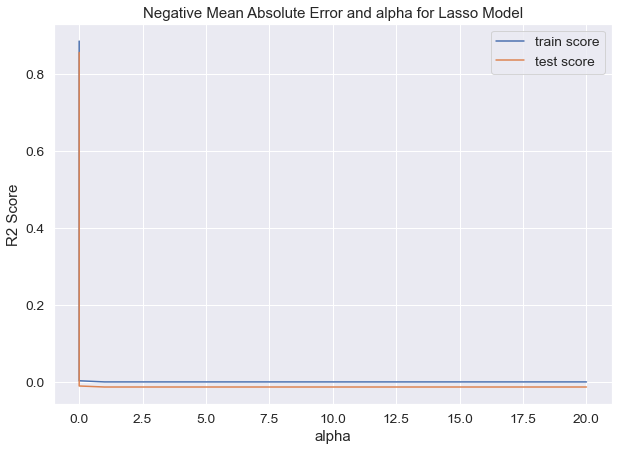

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.004700,0.000458,0.002203,0.000749,0,{'alpha': 0.001},0.868135,0.903424,0.678690,0.875245,0.917278,0.811532,0.839645,0.889577,0.900822,0.880185,0.856453,0.066276,1,0.885165,0.879964,0.901410,0.885420,0.879533,0.891034,0.888399,0.881906,0.883435,0.883306,0.885957,0.006152
1,0.004100,0.000830,0.001999,0.000448,0,{'alpha': 0.001},0.868135,0.903424,0.678690,0.875245,0.917278,0.811532,0.839645,0.889577,0.900822,0.880185,0.856453,0.066276,1,0.885165,0.879964,0.901410,0.885420,0.879533,0.891034,0.888399,0.881906,0.883435,0.883306,0.885957,0.006152
2,0.004400,0.001021,0.002000,0.000447,0,{'alpha': 0.01},0.787849,0.768513,0.700664,0.718193,0.746665,0.705272,0.714943,0.700653,0.809926,0.703708,0.735638,0.038169,3,0.746694,0.747018,0.754842,0.743980,0.741555,0.747616,0.747308,0.750692,0.741022,0.753769,0.747450,0.004404
3,0.006502,0.006946,0.002299,0.000781,0,{'alpha': 0.1},-0.000878,-0.008435,-0.006009,0.001995,0.006282,-0.066530,-0.012689,0.004841,-0.004832,-0.019492,-0.010575,0.020118,4,0.000000,0.000000,0.000000,0.002512,0.010356,0.000000,0.000000,0.007404,0.000000,0.009675,0.002995,0.004151
4,0.005100,0.000538,0.002700,0.000640,1,{'alpha': 1.0},-0.000878,-0.008435,-0.006009,-0.000020,-0.001192,-0.066530,-0.012689,-0.001825,-0.004832,-0.029748,-0.013216,0.019651,5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,0.004798,0.000400,0.003001,0.000447,2,{'alpha': 2.0},-0.000878,-0.008435,-0.006009,-0.000020,-0.001192,-0.066530,-0.012689,-0.001825,-0.004832,-0.029748,-0.013216,0.019651,5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,0.004000,0.001000,0.002300,0.000458,3,{'alpha': 3.0},-0.000878,-0.008435,-0.006009,-0.000020,-0.001192,-0.066530,-0.012689,-0.001825,-0.004832,-0.029748,-0.013216,0.019651,5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,0.004399,0.000663,0.002600,0.000490,4,{'alpha': 4.0},-0.000878,-0.008435,-0.006009,-0.000020,-0.001192,-0.066530,-0.012689,-0.001825,-0.004832,-0.029748,-0.013216,0.019651,5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,0.003900,0.000539,0.002200,0.000399,5,{'alpha': 5.0},-0.000878,-0.008435,-0.006009,-0.000020,-0.001192,-0.066530,-0.012689,-0.001825,-0.004832,-0.029748,-0.013216,0.019651,5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
9,0.004000,0.000001,0.001900,0.000700,10,{'alpha': 10.0},-0.000878,-0.008435,-0.006009,-0.000020,-0.001192,-0.066530,-0.012689,-0.001825,-0.004832,-0.029748,-0.013216,0.019651,5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [75]:
# Tune Lasso Model
lasso_cv_results,lasso_cv_model = tune_paramters_for_model(lasso,params)
lasso_cv_results

In [76]:
print(f'The best value of alpha for Lasso model is {lasso_cv_model.best_params_} and best score is {lasso_cv_model.best_score_}')

The best value of alpha for Lasso model is {'alpha': 0.001} and best score is 0.8564533893520924


In [77]:
X_test_rfe = X_test[X_train_rfe.columns]

In [78]:
lasso_model = Lasso(alpha = 0.001)

print('Training Lasso Model with optimal alpha......')
print()
model,scores = fit_evalaute_one_model(lasso_model,X_train_rfe, X_test_rfe, y_train, y_test)
print(f'Results: {scores}')

Training Lasso Model with optimal alpha......

Results: {'model': 'Lasso', 'training_r2': 0.884072788407257, 'testing_r2': 0.8802728184834513}


In [79]:
ridge_model = Ridge(alpha=3)
print('Training Ridge Model with optimal alpha......')
print()
model,scores = fit_evalaute_one_model(ridge_model,X_train_rfe, X_test_rfe, y_train, y_test)
print(f'Results: {scores}')

Training Ridge Model with optimal alpha......

Results: {'model': 'Ridge', 'training_r2': 0.8955799622587268, 'testing_r2': 0.8771027545882633}


We can see that Lasso produces the best score on the test set. <br>
Moreover the difference in R2 Score between training and testing is not too much and also it can help in feature selection.

We will choose Lasso as our final model.

## Feature Importance

In [80]:
def interpret_model(model,hide_zero_coef=True):
    '''
    Function to interpret the model using the coefficient for the features
    '''
    model_parameters = list(model.coef_)
    model_parameters.insert(0, model.intercept_)
    model_parameters = [round(x, 3) for x in model_parameters]
    cols = X_train_rfe.columns
    cols = cols.insert(0, "constant")
    model_coefficients = pd.DataFrame(list(zip(cols,model_parameters)))
    model_coefficients.columns = ['Feature','Coef']
    if hide_zero_coef:
        model_coefficients = model_coefficients[model_coefficients.Coef !=  0]
    plt.figure(figsize=(18,11))
    
    splot = sns.barplot(y = model_coefficients[model_coefficients.Feature!='constant'].Coef,x = model_coefficients[model_coefficients.Feature!='constant'].Feature)
    

    for p in splot.patches:
        splot.annotate(format(p.get_height(), '.2f'), 
                    (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', 
                    xytext = (0, 9), 
                    textcoords = 'offset points')
    
    plt.title(f"Feature Importance for {str(model.__class__).split('.')[-1][:-2]}",fontsize = 20)
    plt.xlabel(xlabel = 'Features',fontsize = 18)
    plt.ylabel(ylabel = 'Coefficients',fontsize = 18)
    plt.yticks(fontsize = 14 )
    plt.xticks(rotation = 90)
    plt.show()

    return model_coefficients

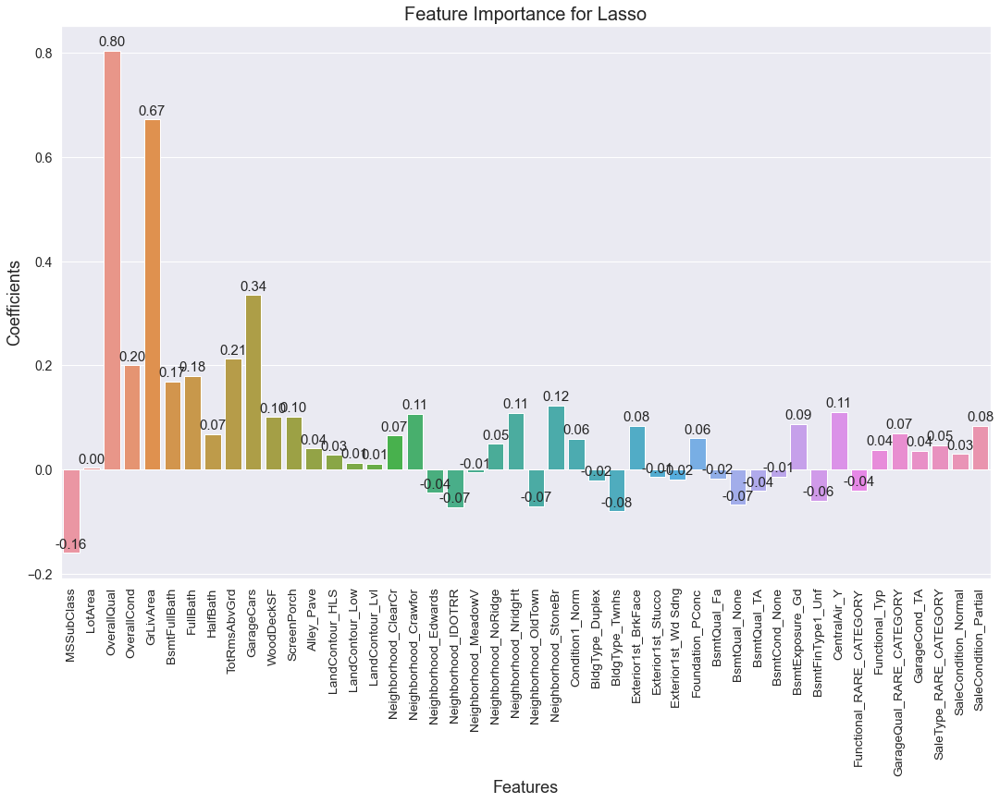

In [81]:
# Interpret Lasso Model
lasso_model_coefficients = interpret_model(lasso_model)

From the above plot we can interpret that the features like `OverallQual` and `GrLivArea` have a positive impact on the SalePrice.

Features like `MSSubClass` have a negative effect on the `SalePrice`.

In [82]:
# Top Features that define a high SalePrice.
lasso_model_coefficients.sort_values(by='Coef',ascending=False).head(10)

,Feature,Coef
0,constant,10.700
4,OverallQual,0.804
9,GrLivArea,0.672
14,GarageCars,0.335
13,TotRmsAbvGrd,0.213
5,OverallCond,0.200
11,FullBath,0.180
10,BsmtFullBath,0.169
32,Neighborhood_StoneBr,0.123
54,CentralAir_Y,0.111


The top 5 Lasso selected features that define a high `SalePrice` are:

1. __`OverallQual`__
2. __`GrLivArea`__ 
3. __`GarageCars`__
4. __`TotRmsAbvGrd`__
5. __`OverallCond`__

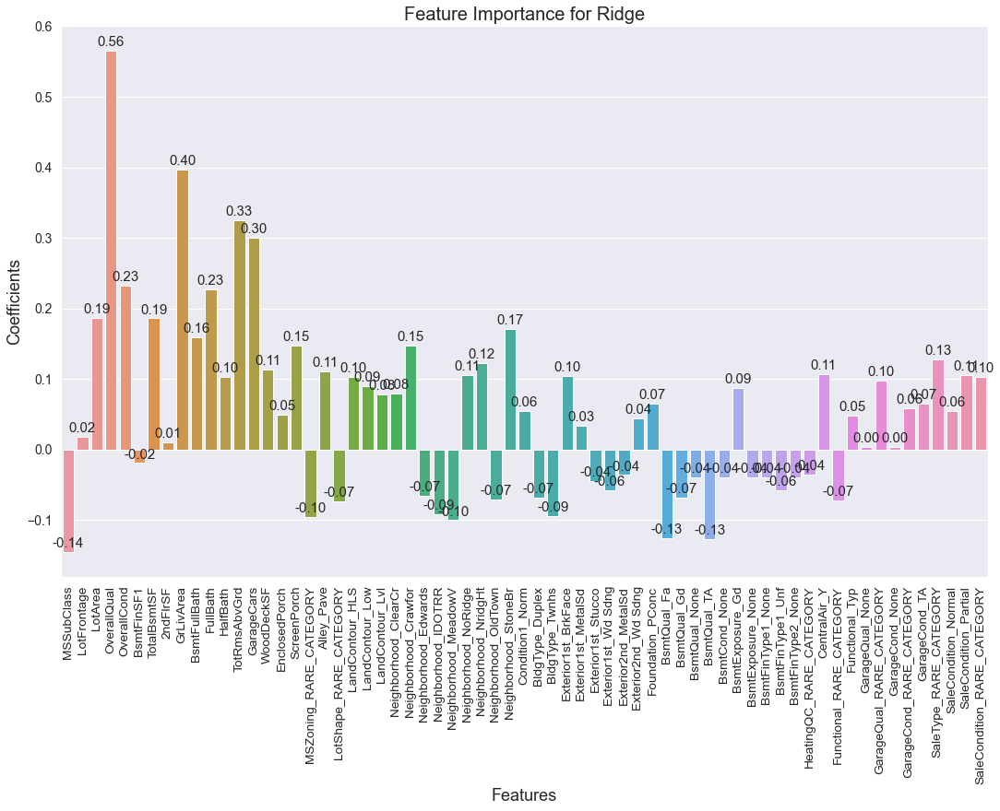

In [83]:
# Interpret Ridge Model
ridge_model_coefficients = interpret_model(ridge_model)

In [84]:
# Top Ridge Features that define a high SalePrice.
ridge_model_coefficients.sort_values(by='Coef',ascending=False).head(10)

,Feature,Coef
0,constant,10.721
4,OverallQual,0.565
9,GrLivArea,0.397
13,TotRmsAbvGrd,0.325
14,GarageCars,0.300
5,OverallCond,0.232
11,FullBath,0.227
3,LotArea,0.187
7,TotalBsmtSF,0.186
32,Neighborhood_StoneBr,0.171


The top 5 Ridge selected features that define a high `SalePrice` are:

1. __`OverallQual`__
2. __`ScreenPorch`__ 
3. __`HalfBath`__
4. __`Alley_Pave`__
5. __`OverallCond`__

## Subjective Questions

__Question.__   

            What is the optimal value of alpha for ridge and lasso regression? 
            What will be the changes in the model if you choose double the value of alpha for both ridge and lasso?
            What will be the most important predictor variables after the change is implemented?

__Answer__ : The optimal value of alpha for `Ridge regression` is `3` and for `Lasso Regression` is `0.001`    

Training Lasso Model with optimal alpha......

Results: {'model': 'Lasso', 'training_r2': 0.8678067482140737, 'testing_r2': 0.865785830190045}


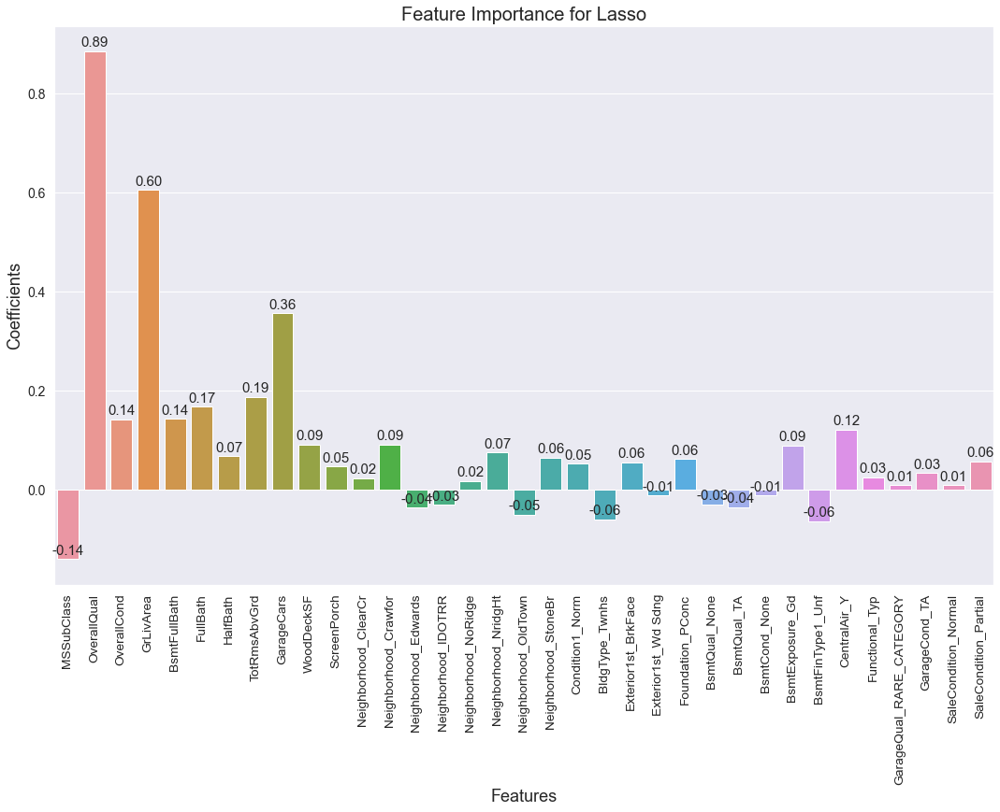

,Feature,Coef
0,constant,10.754
4,OverallQual,0.885
9,GrLivArea,0.605
14,GarageCars,0.356
13,TotRmsAbvGrd,0.187
11,FullBath,0.167
10,BsmtFullBath,0.143
5,OverallCond,0.142
54,CentralAir_Y,0.121
15,WoodDeckSF,0.091


In [85]:
#  if we choose double the alpha values for Lasso then:
lasso_new_model = Lasso(alpha=0.002)
print('Training Lasso Model with optimal alpha......')
print()
lasso_new_model,scores = fit_evalaute_one_model(lasso_new_model,X_train_rfe, X_test_rfe, y_train, y_test)
print(f'Results: {scores}')

lasso_new_model_coefficients = interpret_model(lasso_new_model)
lasso_new_model_coefficients.sort_values(by='Coef',ascending=False).head(10)

It seems for Lasso, on doubling the alpha value the testset R-Squared goes down from 88.02% to 86.58%

Training Ridge Model with optimal alpha......

Results: {'model': 'Ridge', 'training_r2': 0.8891595371384746, 'testing_r2': 0.8718133209748427}


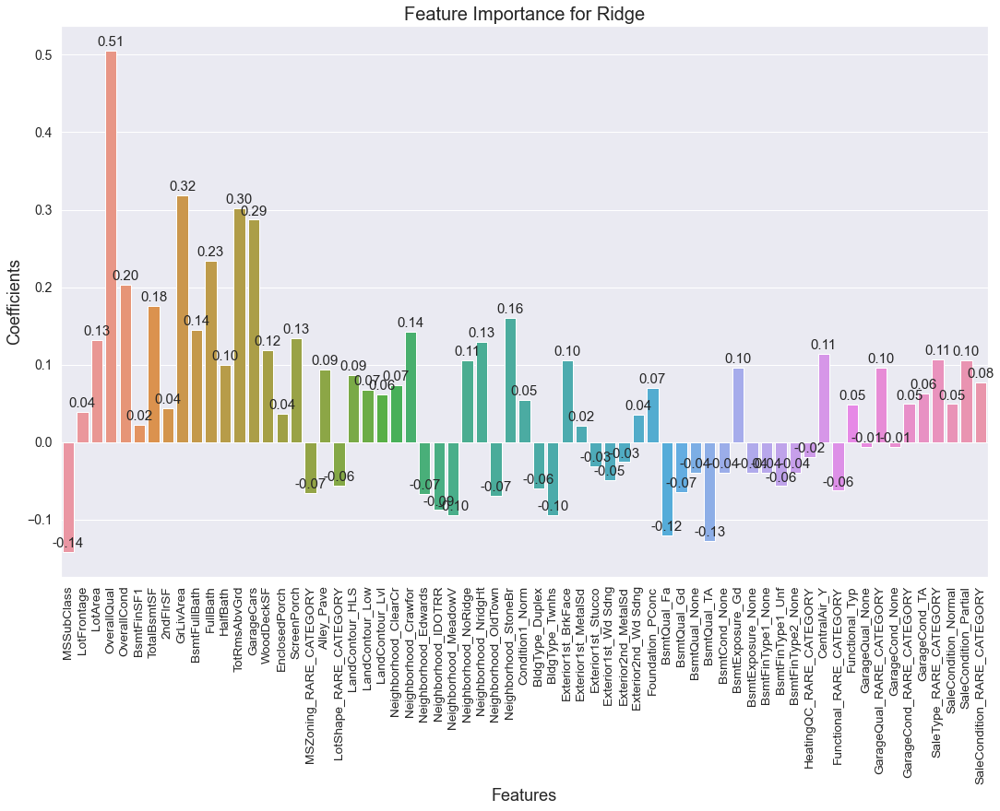

,Feature,Coef
0,constant,10.810
4,OverallQual,0.505
9,GrLivArea,0.318
13,TotRmsAbvGrd,0.302
14,GarageCars,0.287
11,FullBath,0.234
5,OverallCond,0.203
7,TotalBsmtSF,0.176
32,Neighborhood_StoneBr,0.160
10,BsmtFullBath,0.145


In [86]:
#  if we choose double the alpha values for Ridge then:
ridge_new_model = Ridge(alpha=6)
print('Training Ridge Model with optimal alpha......')
print()
ridge_new_model,scores = fit_evalaute_one_model(ridge_new_model,X_train_rfe, X_test_rfe, y_train, y_test)
print(f'Results: {scores}')


ridge_new_model_coefficients = interpret_model(ridge_new_model)
ridge_new_model_coefficients.sort_values(by='Coef',ascending=False).head(10)

It can also be seen that for Ridge, on doubling the alpha value the testset R-Squared goes down from 87.71% to 87.18%

_There is a slight change in the important predictor variables in case of Lasso, but there are noticeable differences in case of Ridge in terms of important predictor variables. _

__Question.__   

            After building the model, you realised that the five most important predictor variables in the lasso model
            are not available in the incoming data. You will now have to create another model excluding the five most important predictor variables.
            Which are the five most important predictor variables now?    

The top 5 Lasso selected features that define a high `SalePrice` are:

1. __`OverallQual`__
2. __`GrLivArea`__ 
3. __`GarageCars`__
4. __`TotRmsAbvGrd`__
5. __`OverallCond`__

In [87]:
# Build lasso model without the top features
X_train_rfe = X_train_rfe.drop(columns=['OverallQual','GrLivArea','GarageCars','TotRmsAbvGrd','OverallCond'])
X_test_rfe = X_test_rfe.drop(columns=['OverallQual','GrLivArea','GarageCars','TotRmsAbvGrd','OverallCond'])

In [88]:
lasso_model_new_variables = Lasso(alpha = 0.001)
print('Training Lasso Model with optimal alpha......')
print()
model,scores = fit_evalaute_one_model(lasso_model_new_variables,X_train_rfe, X_test_rfe, y_train, y_test)
print(f'Results: {scores}')

Training Lasso Model with optimal alpha......

Results: {'model': 'Lasso', 'training_r2': 0.8241064303727492, 'testing_r2': 0.8177082545383276}


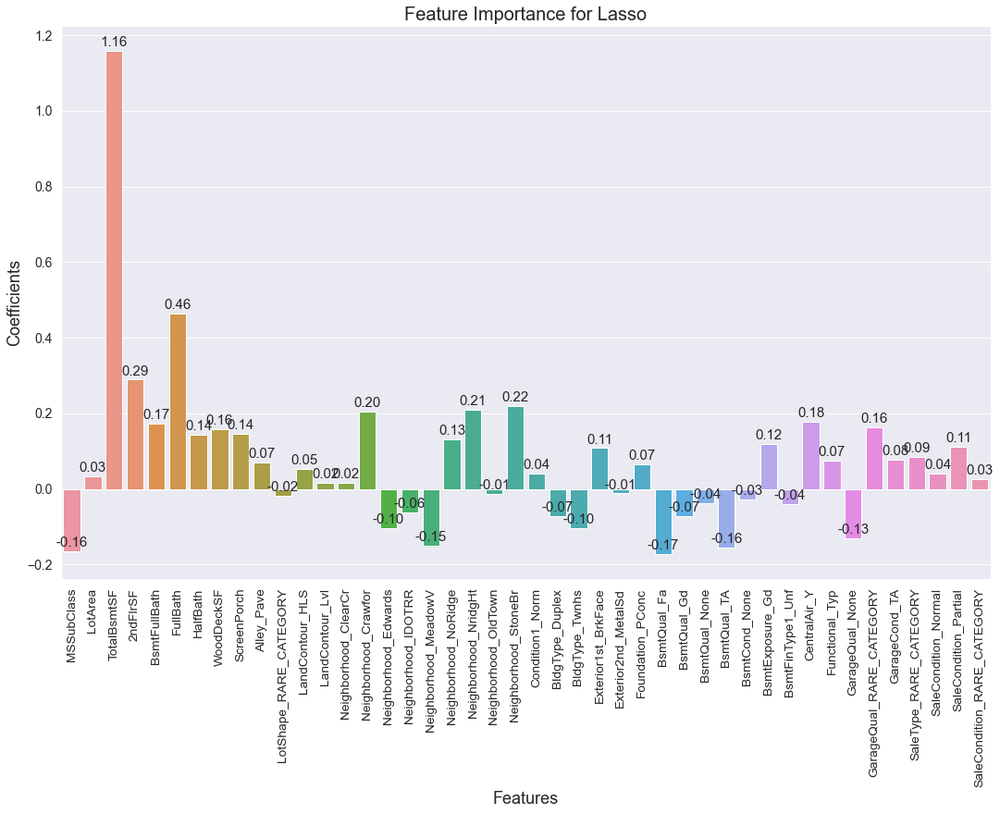

,Feature,Coef
0,constant,11.157
5,TotalBsmtSF,1.158
8,FullBath,0.464
6,2ndFlrSF,0.289
27,Neighborhood_StoneBr,0.220
25,Neighborhood_NridgHt,0.210
20,Neighborhood_Crawfor,0.204
49,CentralAir_Y,0.177
7,BsmtFullBath,0.173
53,GarageQual_RARE_CATEGORY,0.163


In [89]:
lasso_model_new_variables = interpret_model(lasso_model_new_variables)
lasso_model_new_variables.sort_values(by='Coef',ascending=False).head(10)

Now the top variables are:

1. __`TotalBsmtSF`__
2. __`FullBath`__ 
3. __`2ndFlrSF`__
4. __`Neighborhood_StoneBr`__
5. __`Neighborhood_NridgHt`__